In [1]:
.libPaths(c("/home/student/anaconda3/envs/renvrspot/lib/R/library",
            "/home/student/anaconda3/envs/renvr4vec/lib/R/library",
            "/home/student/anaconda3/envs/meringue/lib/R/library",
            "/home/student/anaconda3/envs/envrstd/lib/R/library",
            "/home/student/anaconda3/lib/R/library/","/usr/local/lib/R/site-library/",
            "/usr/lib/R/site-library/","/usr/lib/R/library","/usr/lib/R/library",
            "/home/student/R/x86_64-pc-linux-gnu-library/4.5/",.libPaths()))

In [2]:
library(MERINGUE)
library(Matrix)
library(STdeconvolve)
library(SpotClean)
library(S4Vectors)


Warning message:
“package ‘MERINGUE’ was built under R version 4.5.0”

Attaching package: ‘STdeconvolve’


The following objects are masked from ‘package:MERINGUE’:

    cleanCounts, getOverdispersedGenes


Loading required package: stats4

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, saveRDS, setdiff,
    table, tapply, union, unique, unsplit, which.max, which.min



Attaching package: ‘S4Vectors’


The following objects are masked from ‘package:Matrix’:

    expand, unname


The following object is 

In [3]:
setwd("~/projectR1/projectR1/")

In [4]:
mbrain_raw <- read10xRaw("data/raw_feature_bc_matrix/")
mbrain_slide_info <- read10xSlide("data/spatial/tissue_positions_list.csv", 
                                  "data/spatial/tissue_lowres_image.png", 
                                  "data/spatial/scalefactors_json.json")

In [5]:
dim(mbrain_raw)

[1] 32589  4992

Filtered out 21014 genes with average expressions below or equal to 0.1.



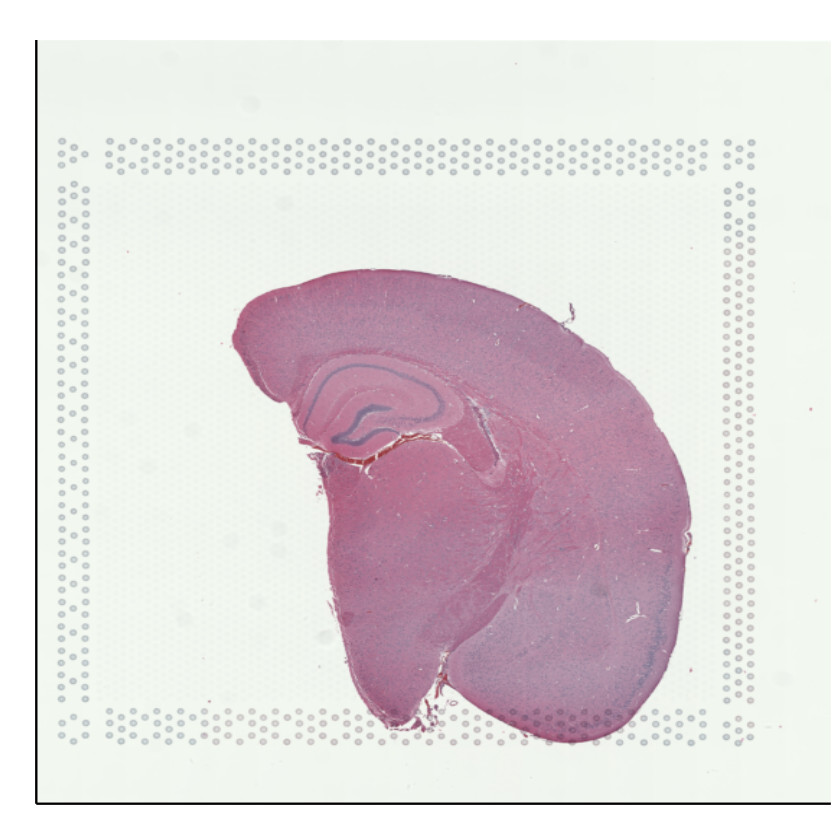

In [6]:
# Visualize raw data
mbrain_obj <- createSlide(count_mat = mbrain_raw, 
                          slide_info = mbrain_slide_info)
visualizeSlide(slide_obj = mbrain_obj)

In [7]:
# Double check some genes
g <- 'Gabbr2'
gg <- 'Gad2'
ggg <- 'Slc17a7'

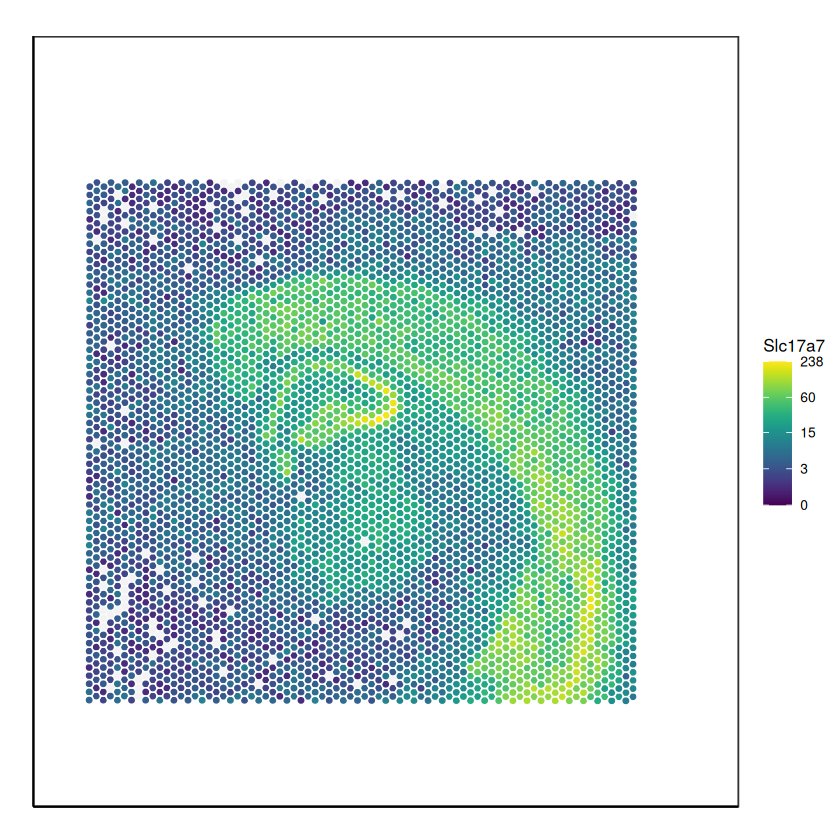

In [8]:
visualizeHeatmap(mbrain_obj,ggg)

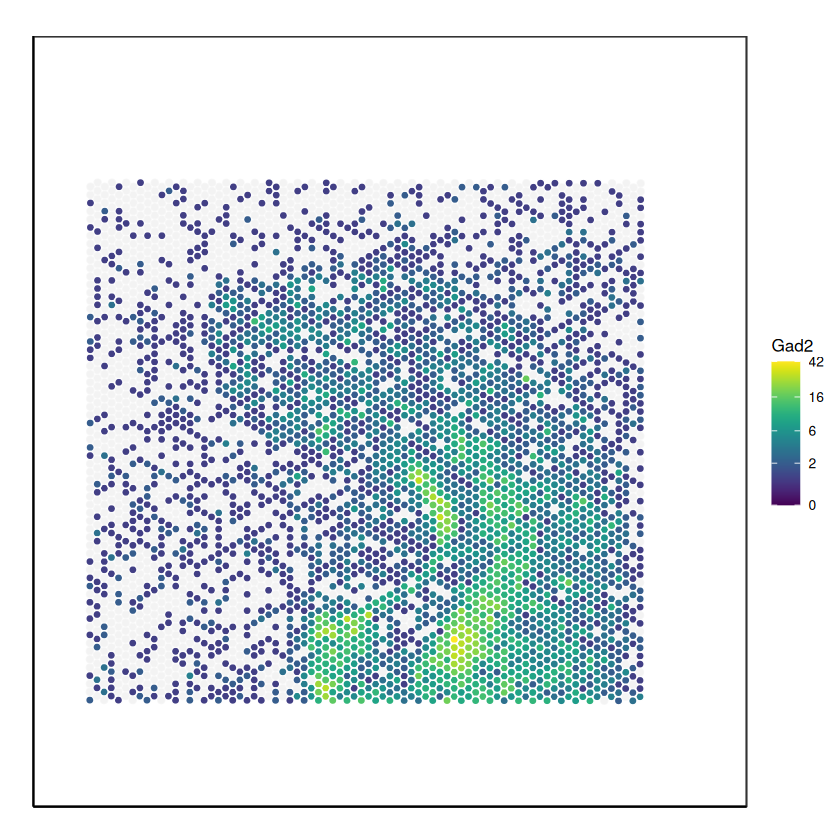

In [9]:
visualizeHeatmap(mbrain_obj,gg)

In [10]:
# Decontaminate raw data
decont_obj <- spotclean(mbrain_obj)

2025-05-01 05:48:02.280057 Start.

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Kept 4575 highly expressed or highly variable genes.

2025-05-01 05:48:05.064699 Estimating contamination parameters...


2025-05-01 05:52:04.954044 Decontaminating genes ...


Iteration: 1

Log-likelihood: 21113825.704
Max difference of decontaminated expressions: 915.228


Iteration: 2

Log-likelihood: 21521194.81
Max difference of decontaminated expressions: 413.074


Iteration: 3

Log-likelihood: 21675319.287
Max difference of decontaminated expressions: 211.429


Iteration: 4

Log-likelihood: 21745987.548
Max difference of decontaminated expressions: 118.03


Iteration: 5

Log-likelihood: 21783259.202
Max difference of decontamina

In [11]:
ls()

[1] "decont_obj"         "g"                  "gg"                
[4] "ggg"                "installed_packages" "mbrain_obj"        
[7] "mbrain_raw"         "mbrain_slide_info"

In [12]:
environment()

<environment: R_GlobalEnv>

In [13]:
mbrain_raw <- read10xRaw("data/raw_feature_bc_matrix/")

In [14]:
dim(mbrain_raw)

[1] 32589  4992

In [15]:
head(mbrain_raw)

  [[ suppressing 4992 column names ‘AAACAACGAATAGTTC-1’, ‘AAACAAGTATCTCCCA-1’, ‘AAACAATCTACTAGCA-1’ ... ]]



6 x 4992 sparse Matrix of class "dgCMatrix"
                                                                               
Xkr4    . . . . 1 . . . . . . . . 1 . . . . . . . 1 . . . . 1 . . . 1 . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm19938 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . 2 . . . . . . . . 2 . . . . .
                                                                               
Xkr4    . . . . . . . . . . . . 1 . 3 . . 1 . . . . . . . . . . 2 . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm19938 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . 

In [16]:
pos.info <- read.csv('data/spatial/tissue_positions_list.csv',header = F)


In [17]:
ls()

[1] "decont_obj"         "g"                  "gg"                
[4] "ggg"                "installed_packages" "mbrain_obj"        
[7] "mbrain_raw"         "mbrain_slide_info"  "pos.info"

In [18]:
head(pos.info)


,V1,V2,V3,V4,V5,V6
,<chr>,<int>,<int>,<int>,<int>,<int>
1,ACGCCTGACACGCGCT-1,0,0,0,5247,21461
2,TACCGATCCAACACTT-1,0,1,1,5391,21208
3,ATTAAAGCGGACGAGC-1,0,0,2,5537,21460
4,GATAAGGGACGATTAG-1,0,1,3,5682,21207
5,GTGCAAATCACCAATA-1,0,0,4,5827,21460
6,TGTTGGCTGGCGGAAG-1,0,1,5,5972,21207


In [19]:
dim(pos.info)


[1] 4992    6

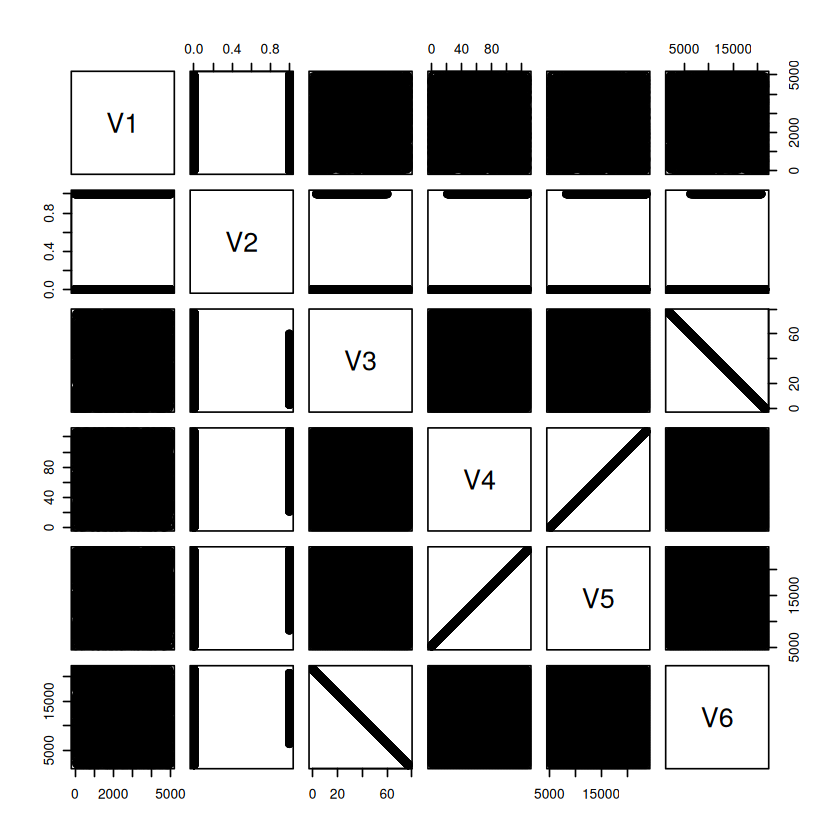

In [20]:
plot(pos.info)


In [21]:
pos <- pos.info[,c(5,6)]


In [22]:
head(pos)


,V5,V6
,<int>,<int>
1,5247,21461
2,5391,21208
3,5537,21460
4,5682,21207
5,5827,21460
6,5972,21207


In [23]:
rownames(pos) <- pos.info[,1]


In [24]:
head(pos)


,V5,V6
,<int>,<int>
ACGCCTGACACGCGCT-1,5247,21461
TACCGATCCAACACTT-1,5391,21208
ATTAAAGCGGACGAGC-1,5537,21460
GATAAGGGACGATTAG-1,5682,21207
GTGCAAATCACCAATA-1,5827,21460
TGTTGGCTGGCGGAAG-1,5972,21207


In [25]:
dim(pos)


[1] 4992    2

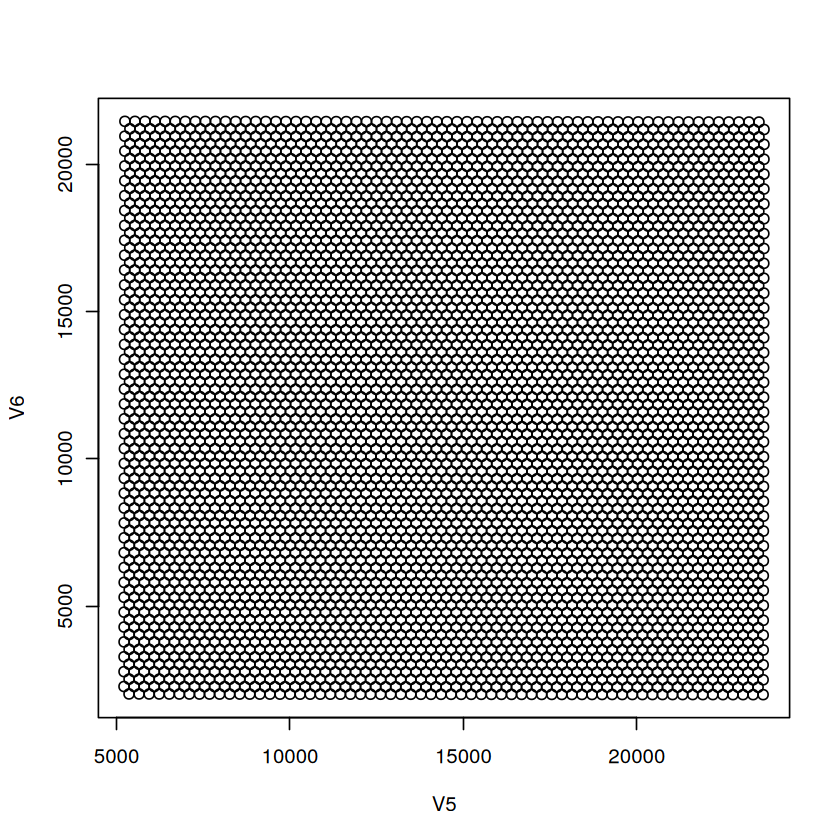

In [26]:
plot(pos)

In [27]:
# library(Matrix)


In [28]:
par(mfrow =c(1,1))

In [29]:
libsize <- colSums(mbrain_raw)


In [30]:
class(mbrain_raw)


[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

In [31]:
 head(libsize)

AAACAACGAATAGTTC-1 AAACAAGTATCTCCCA-1 AAACAATCTACTAGCA-1 AAACACCAATAACTGC-1 
              2791               4008               2714               1681 
AAACAGAGCGACTCCT-1 AAACAGCTTTCAGAAG-1 
             16036               1797

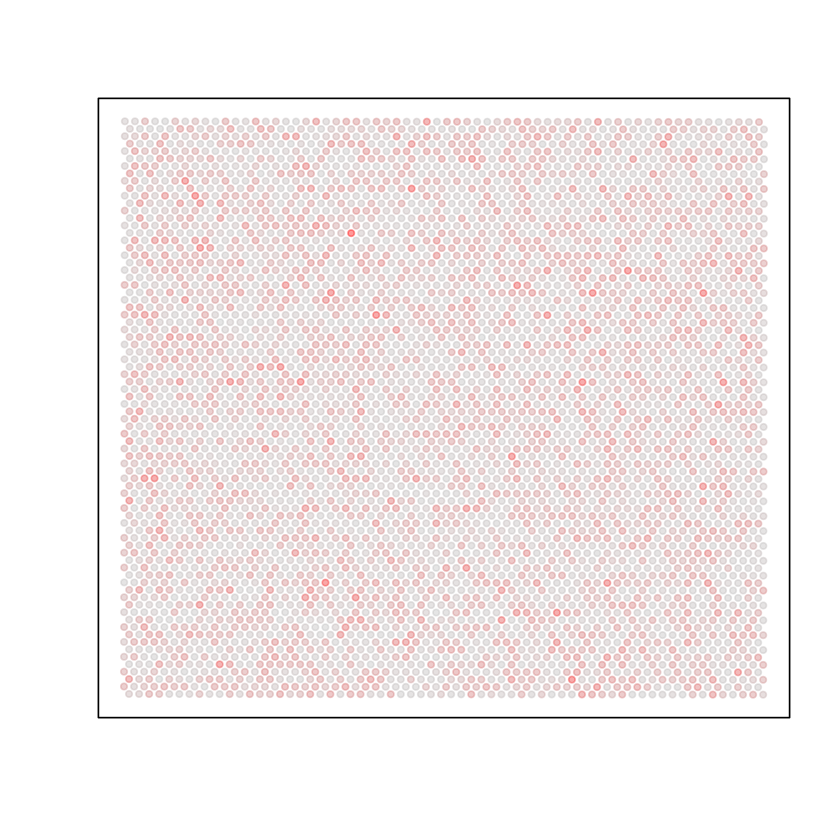

In [32]:
# library(MERINGUE)
MERINGUE::plotEmbedding(pos,col=libsize)

In [33]:
ls()

[1] "decont_obj"         "g"                  "gg"                
 [4] "ggg"                "installed_packages" "libsize"           
 [7] "mbrain_obj"         "mbrain_raw"         "mbrain_slide_info" 
[10] "pos"                "pos.info"

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

AAACAACGAATAGTTC-1 AAACAAGTATCTCCCA-1 AAACAATCTACTAGCA-1 AAACACCAATAACTGC-1 
              2791               4008               2714               1681 
AAACAGAGCGACTCCT-1 AAACAGCTTTCAGAAG-1 
             16036               1797

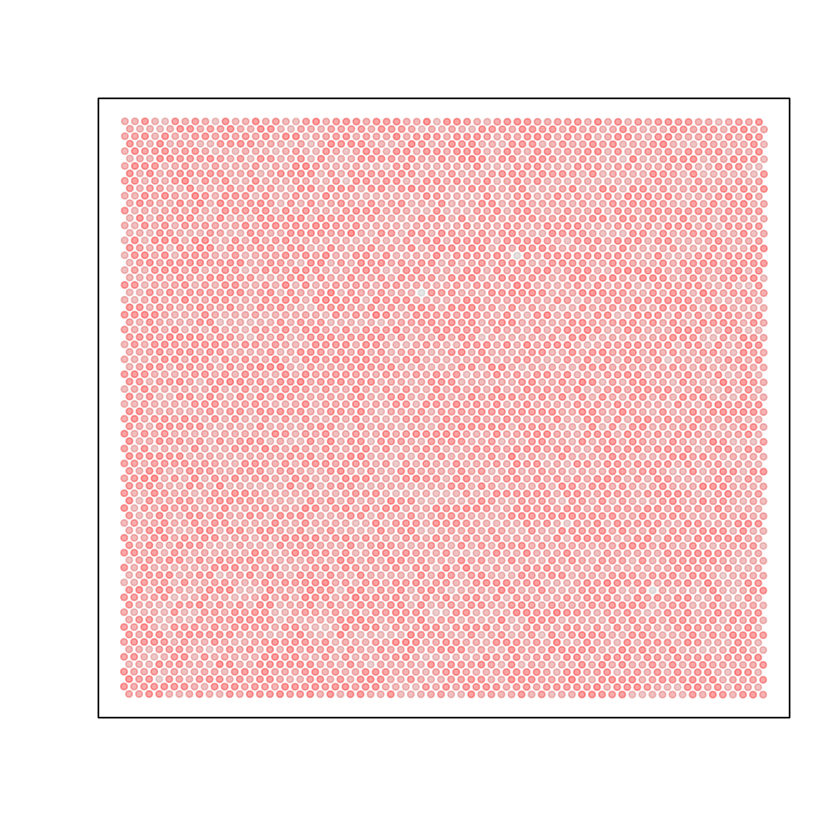

In [34]:
# library(Matrix)
libsize <- colSums(mbrain_raw)
class(mbrain_raw)
head(libsize)
par(mfrow=c(1,1))
# library(MERINGUE)
MERINGUE::plotEmbedding(pos,col=log10(libsize+1))

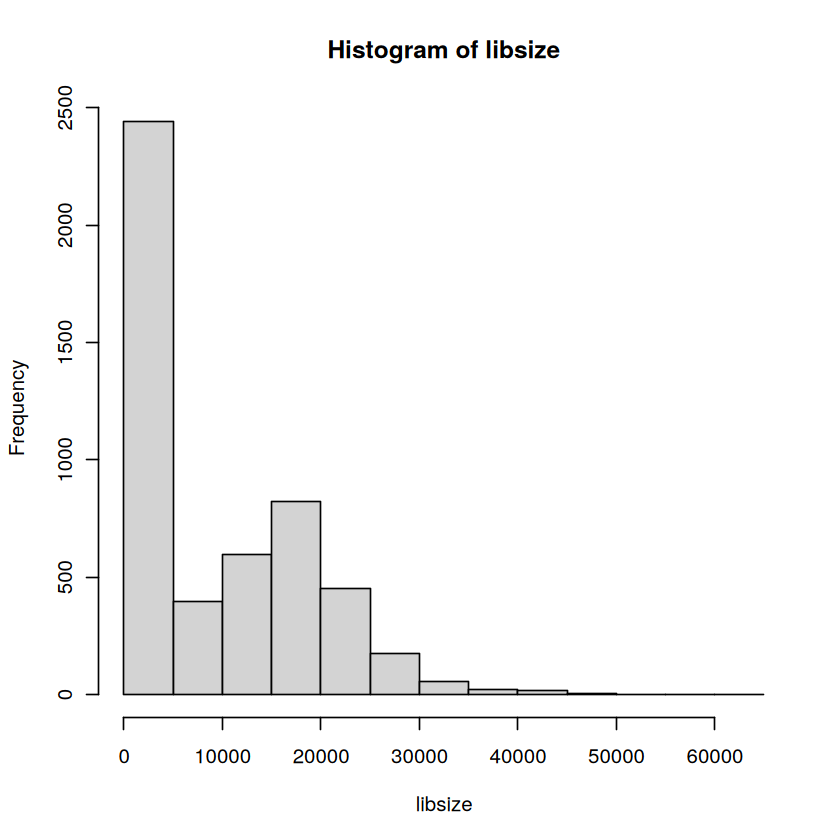

In [35]:
hist(libsize)

In [36]:
countmat <- Matrix::readMM('data/raw_feature_bc_matrix/matrix.mtx.gz')


In [37]:
barcode.info <- read.csv('data/raw_feature_bc_matrix/barcodes.tsv.gz')

In [38]:
barcode.info

AAACAACGAATAGTTC.1
<chr>
AAACAAGTATCTCCCA-1
AAACAATCTACTAGCA-1
AAACACCAATAACTGC-1
AAACAGAGCGACTCCT-1
AAACAGCTTTCAGAAG-1
AAACAGGGTCTATATT-1
AAACAGTGTTCCTGGG-1
AAACATGGTGAGAGGA-1
AAACATTTCCCGGATT-1


In [39]:
rownames(barcode.info)

[1] "1"    "2"    "3"    "4"    "5"    "6"    "7"    "8"    "9"    "10"  
  [11] "11"   "12"   "13"   "14"   "15"   "16"   "17"   "18"   "19"   "20"  
  [21] "21"   "22"   "23"   "24"   "25"   "26"   "27"   "28"   "29"   "30"  
  [31] "31"   "32"   "33"   "34"   "35"   "36"   "37"   "38"   "39"   "40"  
  [41] "41"   "42"   "43"   "44"   "45"   "46"   "47"   "48"   "49"   "50"  
  [51] "51"   "52"   "53"   "54"   "55"   "56"   "57"   "58"   "59"   "60"  
  [61] "61"   "62"   "63"   "64"   "65"   "66"   "67"   "68"   "69"   "70"  
  [71] "71"   "72"   "73"   "74"   "75"   "76"   "77"   "78"   "79"   "80"  
  [81] "81"   "82"   "83"   "84"   "85"   "86"   "87"   "88"   "89"   "90"  
  [91] "91"   "92"   "93"   "94"   "95"   "96"   "97"   "98"   "99"   "100" 
 [101] "101"  "102"  "103"  "104"  "105"  "106"  "107"  "108"  "109"  "110" 
 [111] "111"  "112"  "113"  "114"  "115"  "116"  "117"  "118"  "119"  "120" 
 [121] "121"  "122"  "123"  "124"  "125"  "126"  "127"  "128"  "129"  "130" 
 [131] "131"  "132"  "133"  "134"  "135"  "136"  "137"  "138"  "139"  "140" 
 [141] "141"  "142"  "143"  "144"  "145"  "146"  "147"  "148"  "149"  "150" 
 [151] "151"  "152"  "153"  "154"  "155"  "156"  "157"  "158"  "159"  "160" 
 [161] "161"  "162"  "163"  "164"  "165"  "166"  "167"  "168"  "169"  "170" 
 [171] "171"  "172"  "173"  "174"  "175"  "176"  "177"  "178"  "179"  "180" 
 [181] "181"  "182"  "183"  "184"  "185"  "186"  "187"  "188"  "189"  "190" 
 [191] "191"  "192"  "193"  "194"  "195"  "196"  "197"  "198"  "199"  "200" 
 [201] "201"  "202"  "203"  "204"  "205"  "206"  "207"  "208"  "209"  "210" 
 [211] "211"  "212"  "213"  "214"  "215"  "216"  "217"  "218"  "219"  "220" 
 [221] "221"  "222"  "223"  "224"  "225"  "226"  "227"  "228"  "229"  "230" 
 [231] "231"  "232"  "233"  "234"  "235"  "236"  "237"  "238"  "239"  "240" 
 [241] "241"  "242"  "243"  "244"  "245"  "246"  "247"  "248"  "249"  "250" 
 [251] "251"  "252"  "253"  "254"  "255"  "256"  "257"  "258"  "259"  "260" 
 [261] "261"  "262"  "263"  "264"  "265"  "266"  "267"  "268"  "269"  "270" 
 [271] "271"  "272"  "273"  "274"  "275"  "276"  "277"  "278"  "279"  "280" 
 [281] "281"  "282"  "283"  "284"  "285"  "286"  "287"  "288"  "289"  "290" 
 [291] "291"  "292"  "293"  "294"  "295"  "296"  "297"  "298"  "299"  "300" 
 [301] "301"  "302"  "303"  "304"  "305"  "306"  "307"  "308"  "309"  "310" 
 [311] "311"  "312"  "313"  "314"  "315"  "316"  "317"  "318"  "319"  "320" 
 [321] "321"  "322"  "323"  "324"  "325"  "326"  "327"  "328"  "329"  "330" 
 [331] "331"  "332"  "333"  "334"  "335"  "336"  "337"  "338"  "339"  "340" 
 [341] "341"  "342"  "343"  "344"  "345"  "346"  "347"  "348"  "349"  "350" 
 [351] "351"  "352"  "353"  "354"  "355"  "356"  "357"  "358"  "359"  "360" 
 [361] "361"  "362"  "363"  "364"  "365"  "366"  "367"  "368"  "369"  "370" 
 [371] "371"  "372"  "373"  "374"  "375"  "376"  "377"  "378"  "379"  "380" 
 [381] "381"  "382"  "383"  "384"  "385"  "386"  "387"  "388"  "389"  "390" 
 [391] "391"  "392"  "393"  "394"  "395"  "396"  "397"  "398"  "399"  "400" 
 [401] "401"  "402"  "403"  "404"  "405"  "406"  "407"  "408"  "409"  "410" 
 [411] "411"  "412"  "413"  "414"  "415"  "416"  "417"  "418"  "419"  "420" 
 [421] "421"  "422"  "423"  "424"  "425"  "426"  "427"  "428"  "429"  "430" 
 [431] "431"  "432"  "433"  "434"  "435"  "436"  "437"  "438"  "439"  "440" 
 [441] "441"  "442"  "443"  "444"  "445"  "446"  "447"  "448"  "449"  "450" 
 [451] "451"  "452"  "453"  "454"  "455"  "456"  "457"  "458"  "459"  "460" 
 [461] "461"  "462"  "463"  "464"  "465"  "466"  "467"  "468"  "469"  "470" 
 [471] "471"  "472"  "473"  "474"  "475"  "476"  "477"  "478"  "479"  "480" 
 [481] "481"  "482"  "483"  "484"  "485"  "486"  "487"  "488"  "489"  "490" 
 [491] "491"  "492"  "493"  "494"  "495"  "496"  "497"  "498"  "499"  "500" 
 [501] "501"  "502"  "503"  "504"  "505"  "506"  "507"  "508"  "509"  "510" 
 [511] "511"  "512"  "513"  "514"  "515"  "516"  "517"  "518"  "519"  "520" 

In [40]:
colnames(barcode.info)

[1] "AAACAACGAATAGTTC.1"

In [41]:
head(barcode.info)

,AAACAACGAATAGTTC.1
,<chr>
1,AAACAAGTATCTCCCA-1
2,AAACAATCTACTAGCA-1
3,AAACACCAATAACTGC-1
4,AAACAGAGCGACTCCT-1
5,AAACAGCTTTCAGAAG-1
6,AAACAGGGTCTATATT-1


In [42]:
barcode.info <- read.csv('data/raw_feature_bc_matrix/barcodes.tsv.gz',header =F)

In [43]:
rownames(barcode.info)

[1] "1"    "2"    "3"    "4"    "5"    "6"    "7"    "8"    "9"    "10"  
  [11] "11"   "12"   "13"   "14"   "15"   "16"   "17"   "18"   "19"   "20"  
  [21] "21"   "22"   "23"   "24"   "25"   "26"   "27"   "28"   "29"   "30"  
  [31] "31"   "32"   "33"   "34"   "35"   "36"   "37"   "38"   "39"   "40"  
  [41] "41"   "42"   "43"   "44"   "45"   "46"   "47"   "48"   "49"   "50"  
  [51] "51"   "52"   "53"   "54"   "55"   "56"   "57"   "58"   "59"   "60"  
  [61] "61"   "62"   "63"   "64"   "65"   "66"   "67"   "68"   "69"   "70"  
  [71] "71"   "72"   "73"   "74"   "75"   "76"   "77"   "78"   "79"   "80"  
  [81] "81"   "82"   "83"   "84"   "85"   "86"   "87"   "88"   "89"   "90"  
  [91] "91"   "92"   "93"   "94"   "95"   "96"   "97"   "98"   "99"   "100" 
 [101] "101"  "102"  "103"  "104"  "105"  "106"  "107"  "108"  "109"  "110" 
 [111] "111"  "112"  "113"  "114"  "115"  "116"  "117"  "118"  "119"  "120" 
 [121] "121"  "122"  "123"  "124"  "125"  "126"  "127"  "128"  "129"  "130" 
 [131] "131"  "132"  "133"  "134"  "135"  "136"  "137"  "138"  "139"  "140" 
 [141] "141"  "142"  "143"  "144"  "145"  "146"  "147"  "148"  "149"  "150" 
 [151] "151"  "152"  "153"  "154"  "155"  "156"  "157"  "158"  "159"  "160" 
 [161] "161"  "162"  "163"  "164"  "165"  "166"  "167"  "168"  "169"  "170" 
 [171] "171"  "172"  "173"  "174"  "175"  "176"  "177"  "178"  "179"  "180" 
 [181] "181"  "182"  "183"  "184"  "185"  "186"  "187"  "188"  "189"  "190" 
 [191] "191"  "192"  "193"  "194"  "195"  "196"  "197"  "198"  "199"  "200" 
 [201] "201"  "202"  "203"  "204"  "205"  "206"  "207"  "208"  "209"  "210" 
 [211] "211"  "212"  "213"  "214"  "215"  "216"  "217"  "218"  "219"  "220" 
 [221] "221"  "222"  "223"  "224"  "225"  "226"  "227"  "228"  "229"  "230" 
 [231] "231"  "232"  "233"  "234"  "235"  "236"  "237"  "238"  "239"  "240" 
 [241] "241"  "242"  "243"  "244"  "245"  "246"  "247"  "248"  "249"  "250" 
 [251] "251"  "252"  "253"  "254"  "255"  "256"  "257"  "258"  "259"  "260" 
 [261] "261"  "262"  "263"  "264"  "265"  "266"  "267"  "268"  "269"  "270" 
 [271] "271"  "272"  "273"  "274"  "275"  "276"  "277"  "278"  "279"  "280" 
 [281] "281"  "282"  "283"  "284"  "285"  "286"  "287"  "288"  "289"  "290" 
 [291] "291"  "292"  "293"  "294"  "295"  "296"  "297"  "298"  "299"  "300" 
 [301] "301"  "302"  "303"  "304"  "305"  "306"  "307"  "308"  "309"  "310" 
 [311] "311"  "312"  "313"  "314"  "315"  "316"  "317"  "318"  "319"  "320" 
 [321] "321"  "322"  "323"  "324"  "325"  "326"  "327"  "328"  "329"  "330" 
 [331] "331"  "332"  "333"  "334"  "335"  "336"  "337"  "338"  "339"  "340" 
 [341] "341"  "342"  "343"  "344"  "345"  "346"  "347"  "348"  "349"  "350" 
 [351] "351"  "352"  "353"  "354"  "355"  "356"  "357"  "358"  "359"  "360" 
 [361] "361"  "362"  "363"  "364"  "365"  "366"  "367"  "368"  "369"  "370" 
 [371] "371"  "372"  "373"  "374"  "375"  "376"  "377"  "378"  "379"  "380" 
 [381] "381"  "382"  "383"  "384"  "385"  "386"  "387"  "388"  "389"  "390" 
 [391] "391"  "392"  "393"  "394"  "395"  "396"  "397"  "398"  "399"  "400" 
 [401] "401"  "402"  "403"  "404"  "405"  "406"  "407"  "408"  "409"  "410" 
 [411] "411"  "412"  "413"  "414"  "415"  "416"  "417"  "418"  "419"  "420" 
 [421] "421"  "422"  "423"  "424"  "425"  "426"  "427"  "428"  "429"  "430" 
 [431] "431"  "432"  "433"  "434"  "435"  "436"  "437"  "438"  "439"  "440" 
 [441] "441"  "442"  "443"  "444"  "445"  "446"  "447"  "448"  "449"  "450" 
 [451] "451"  "452"  "453"  "454"  "455"  "456"  "457"  "458"  "459"  "460" 
 [461] "461"  "462"  "463"  "464"  "465"  "466"  "467"  "468"  "469"  "470" 
 [471] "471"  "472"  "473"  "474"  "475"  "476"  "477"  "478"  "479"  "480" 
 [481] "481"  "482"  "483"  "484"  "485"  "486"  "487"  "488"  "489"  "490" 
 [491] "491"  "492"  "493"  "494"  "495"  "496"  "497"  "498"  "499"  "500" 
 [501] "501"  "502"  "503"  "504"  "505"  "506"  "507"  "508"  "509"  "510" 
 [511] "511"  "512"  "513"  "514"  "515"  "516"  "517"  "518"  "519"  "520" 

In [44]:
colnames(barcode.info)

[1] "V1"

In [45]:
head(barcode.info)

,V1
,<chr>
1,AAACAACGAATAGTTC-1
2,AAACAAGTATCTCCCA-1
3,AAACAATCTACTAGCA-1
4,AAACACCAATAACTGC-1
5,AAACAGAGCGACTCCT-1
6,AAACAGCTTTCAGAAG-1


In [46]:
barcode.info


V1
<chr>
AAACAACGAATAGTTC-1
AAACAAGTATCTCCCA-1
AAACAATCTACTAGCA-1
AAACACCAATAACTGC-1
AAACAGAGCGACTCCT-1
AAACAGCTTTCAGAAG-1
AAACAGGGTCTATATT-1
AAACAGTGTTCCTGGG-1
AAACATGGTGAGAGGA-1


In [47]:
# library(Matrix)


In [48]:
countmat <- Matrix::readMM('data/raw_feature_bc_matrix/matrix.mtx.gz')


In [49]:
barcode.info <- read.csv('data/raw_feature_bc_matrix/barcodes.tsv.gz')

In [50]:
gene.info <- read.csv('data/raw_feature_bc_matrix/features.tsv.gz',header = FALSE)

In [51]:
head(gene.info)

,V1
,<chr>
1,ENSMUSG00000051951 Xkr4 Gene Expression
2,ENSMUSG00000089699 Gm1992 Gene Expression
3,ENSMUSG00000102331 Gm19938 Gene Expression
4,ENSMUSG00000102343 Gm37381 Gene Expression
5,ENSMUSG00000025900 Rp1 Gene Expression
6,ENSMUSG00000025902 Sox17 Gene Expression


In [52]:
gene.info <- read.csv('data/raw_feature_bc_matrix/features.tsv.gz', header = FALSE, sep="\t")

In [53]:
head(gene.info)



,V1,V2,V3
,<chr>,<chr>,<chr>
1,ENSMUSG00000051951,Xkr4,Gene Expression
2,ENSMUSG00000089699,Gm1992,Gene Expression
3,ENSMUSG00000102331,Gm19938,Gene Expression
4,ENSMUSG00000102343,Gm37381,Gene Expression
5,ENSMUSG00000025900,Rp1,Gene Expression
6,ENSMUSG00000025902,Sox17,Gene Expression


In [54]:
#change again

In [55]:
countmat <- Matrix::readMM('data/raw_feature_bc_matrix/matrix.mtx.gz')


In [56]:
barcode.info <- read.csv('data/raw_feature_bc_matrix/barcodes.tsv.gz',header =FALSE)

In [57]:
barcode <- barcode.info[,1]

In [58]:
head(barcode)

[1] "AAACAACGAATAGTTC-1" "AAACAAGTATCTCCCA-1" "AAACAATCTACTAGCA-1"
[4] "AAACACCAATAACTGC-1" "AAACAGAGCGACTCCT-1" "AAACAGCTTTCAGAAG-1"

In [59]:
gene.info <- read.csv('data/raw_feature_bc_matrix/features.tsv.gz', header = FALSE, sep="\t")

In [60]:
head(gene.info)

,V1,V2,V3
,<chr>,<chr>,<chr>
1,ENSMUSG00000051951,Xkr4,Gene Expression
2,ENSMUSG00000089699,Gm1992,Gene Expression
3,ENSMUSG00000102331,Gm19938,Gene Expression
4,ENSMUSG00000102343,Gm37381,Gene Expression
5,ENSMUSG00000025900,Rp1,Gene Expression
6,ENSMUSG00000025902,Sox17,Gene Expression


In [61]:
gene <- gene.info[,2] 

In [62]:
head(gene)

[1] "Xkr4"    "Gm1992"  "Gm19938" "Gm37381" "Rp1"     "Sox17"

In [63]:
dim(countmat)

[1] 32589  4992

In [64]:
length(barcode)

[1] 4992

In [65]:
length(gene)

[1] 32589

In [66]:
#36:04

In [67]:
dim(countmat)

[1] 32589  4992

Warning message in MERINGUE::plotEmbedding(pos, col = libsize):
“provided cluster vector doesn't list colors for all of the cells; unmatched cells will be shown in gray. ”


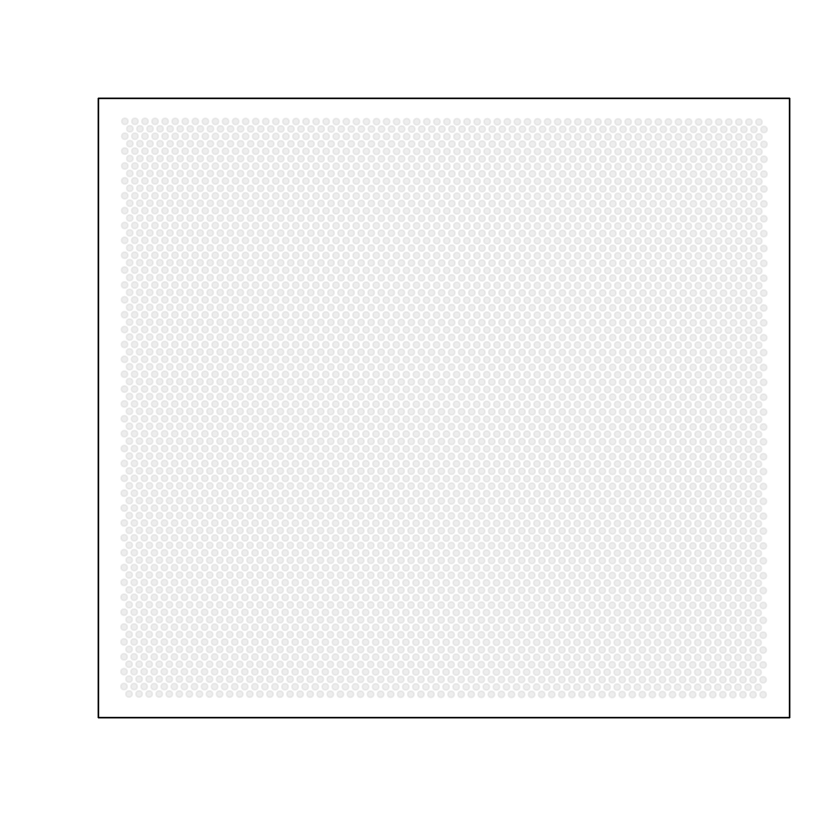

In [68]:
library(Matrix)
libsize <- colSums(countmat)
par(mfrow=c(1,1))
# library(MERINGUE)
MERINGUE::plotEmbedding(pos,col=libsize)

In [69]:
library(Matrix)


In [70]:
libsize <- colSums(countmat)

In [71]:
par(mfrow=c(1,1))

Warning message in MERINGUE::plotEmbedding(pos, col = libsize):
“provided cluster vector doesn't list colors for all of the cells; unmatched cells will be shown in gray. ”


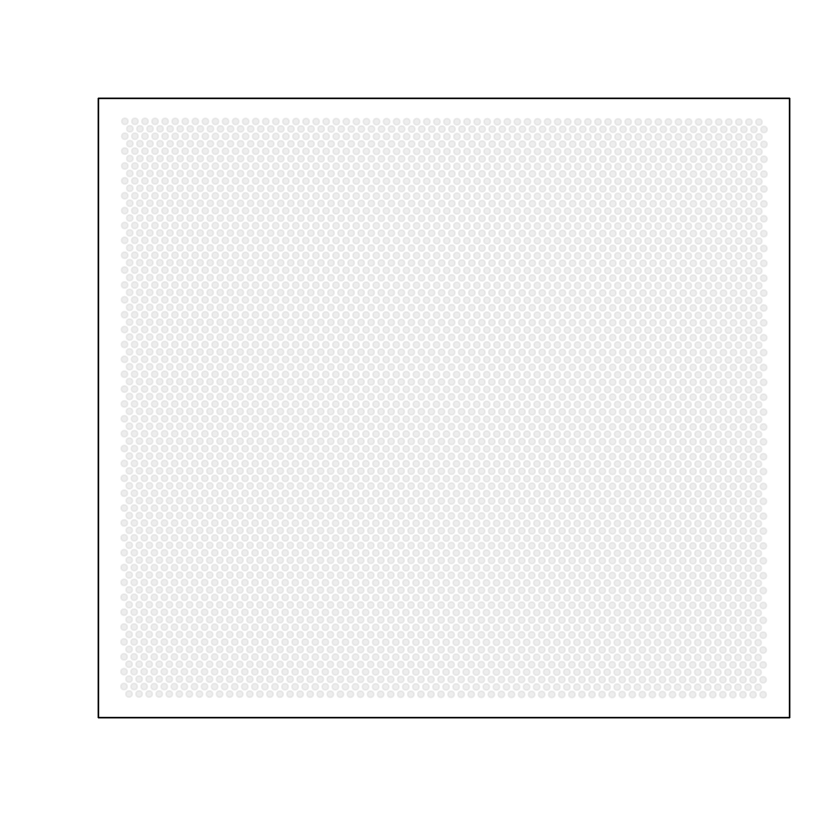

In [72]:
MERINGUE::plotEmbedding(pos,col=libsize)

In [73]:
# Save plots to PDF, specifying dimensions
#pdf('a.pdf')
#MERINGUE::plotEmbedding(pos,col=libsize)
#dev.off()

In [74]:
ls()

[1] "barcode"            "barcode.info"       "countmat"          
 [4] "decont_obj"         "g"                  "gene"              
 [7] "gene.info"          "gg"                 "ggg"               
[10] "installed_packages" "libsize"            "mbrain_obj"        
[13] "mbrain_raw"         "mbrain_slide_info"  "pos"               
[16] "pos.info"

In [75]:
library(Matrix)

In [76]:
countmat <- Matrix::readMM('data/raw_feature_bc_matrix/matrix.mtx.gz')

In [77]:
barcode.info <- read.csv('data/raw_feature_bc_matrix/barcodes.tsv.gz')

In [78]:
colnames(countmat) <-barcode

In [79]:
rownames(countmat) <-make.unique(gene)

In [80]:
libsize <- colSums(countmat)

In [81]:
dim(countmat)

[1] 32589  4992

In [82]:
par(mfrow=c(1,1))

In [83]:
36:18

[1] 36 35 34 33 32 31 30 29 28 27 26 25 24 23 22 21 20 19 18

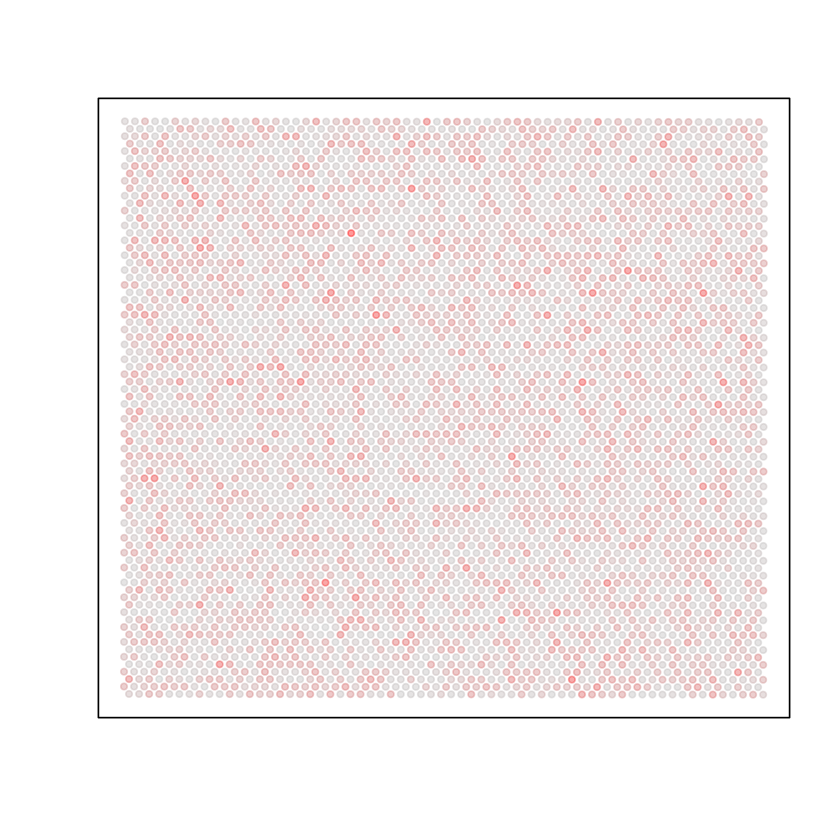

In [84]:
MERINGUE::plotEmbedding(pos, col=libsize)

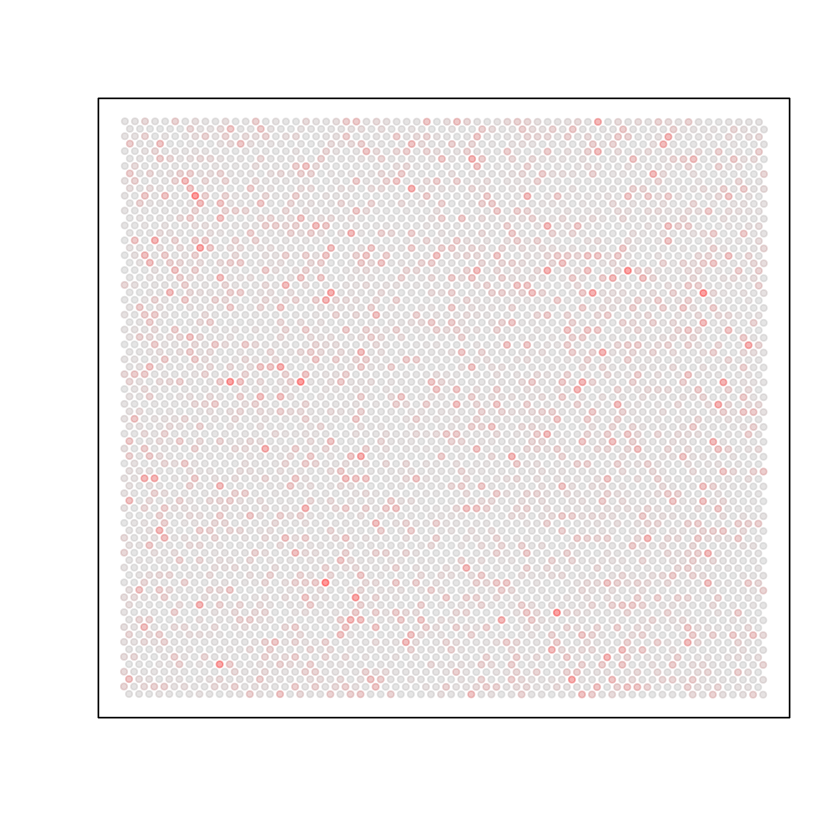

In [85]:
g <- 'Slc17a7'
gexp <- countmat[g,]
MERINGUE::plotEmbedding(pos, col=gexp) 

In [86]:
head(gexp)

AAACAACGAATAGTTC-1 AAACAAGTATCTCCCA-1 AAACAATCTACTAGCA-1 AAACACCAATAACTGC-1 
                 7                  5                  8                  4 
AAACAGAGCGACTCCT-1 AAACAGCTTTCAGAAG-1 
                38                  2

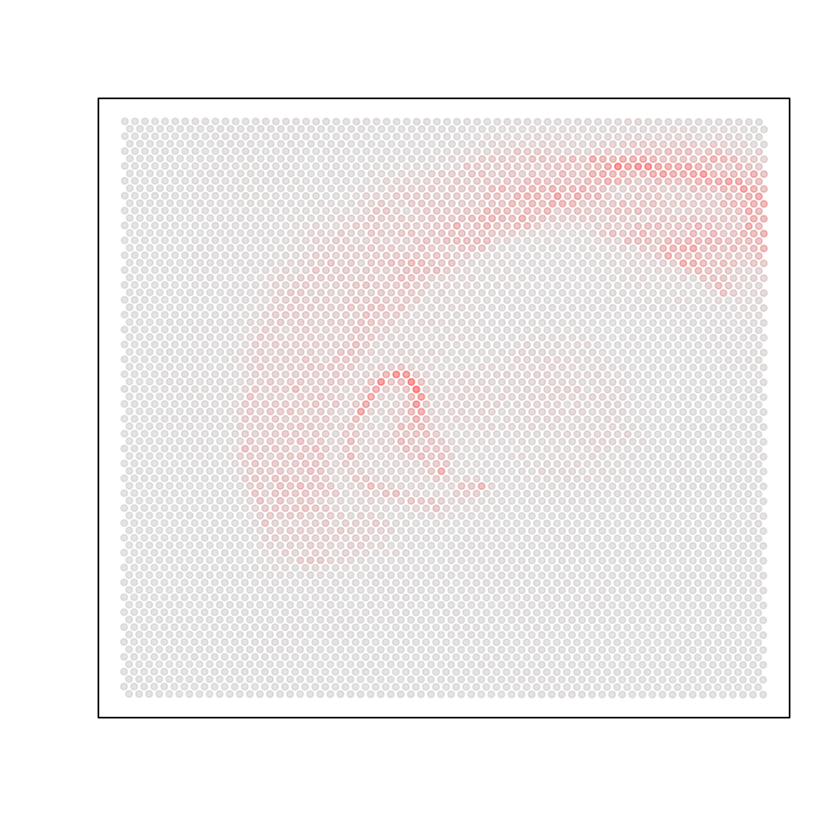

In [87]:
MERINGUE::plotEmbedding(pos, col=gexp[rownames(pos)]) 

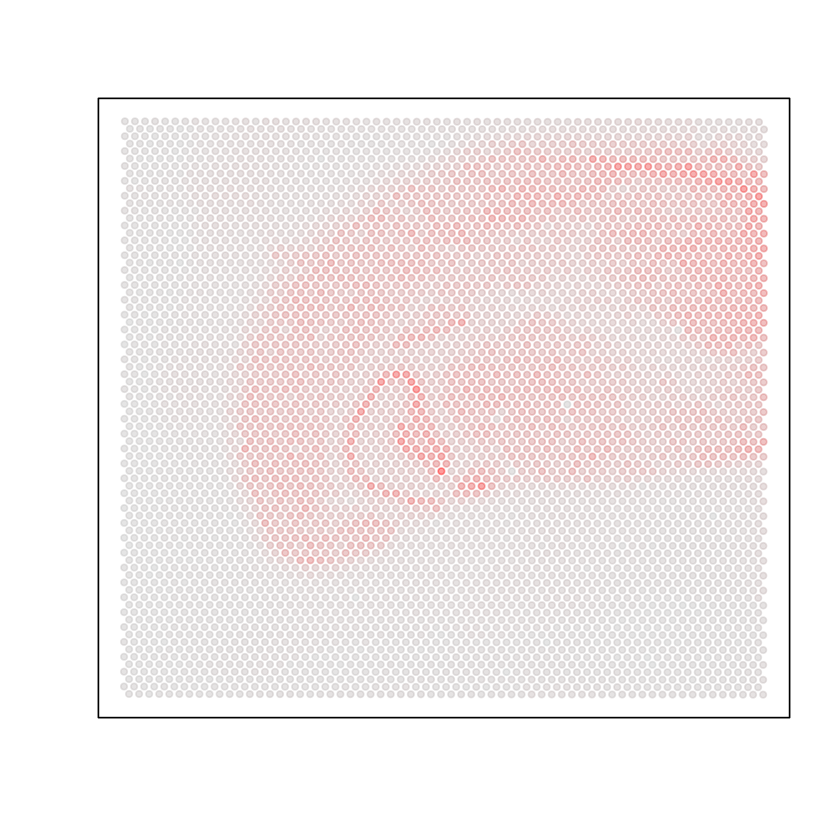

In [88]:
####now FIX ORDER
pos <- pos[colnames(countmat),]
###and  FIX POSITION

#library(Matrix)

pos <- pos[,c(2,1)]
libsize <- colSums(countmat)
par(mfrow = c(1,1))
g <- 'Slc17a7'
MERINGUE::plotEmbedding(pos[,c(2,1)], col=libsize) 
##sawp X and Y  pos[,c(2,1)]  
#the picture is upside down so switched y posiion

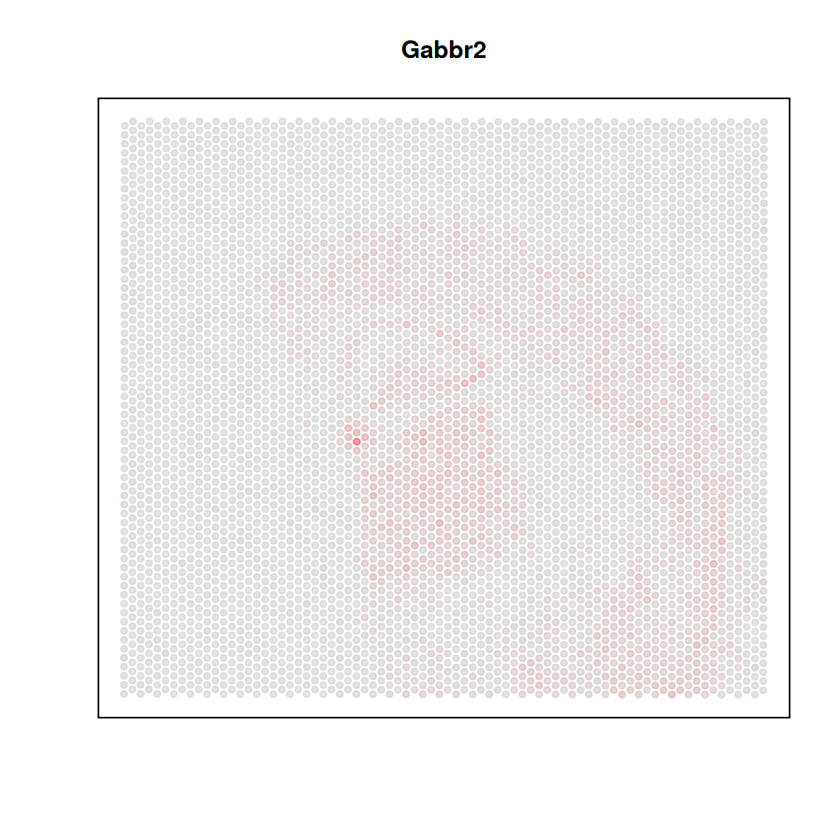

In [89]:
###and  FIX POSITION
pos.info <- read.csv('data/spatial/tissue_positions_list.csv',header = F)
pos <- pos.info[,c(5,6)]
rownames(pos) <- pos.info[,1]






pos <- pos[colnames(countmat),]

pos <- pos[,c(2,1)]
pos[,2] <- -pos[,2]
pos[,2] <- pos[,2] - min(pos[,2])



libsize <- colSums(countmat)
par(mfrow = c(1,1))



g <- 'Gabbr2'
gg <- 'Gad2'
ggg <- 'Slc17a7'
gexp <- countmat[g,]
MERINGUE::plotEmbedding(pos, col=gexp[rownames(pos)],main=g) 

##sawp X and Y  pos[,c(2,1)]  







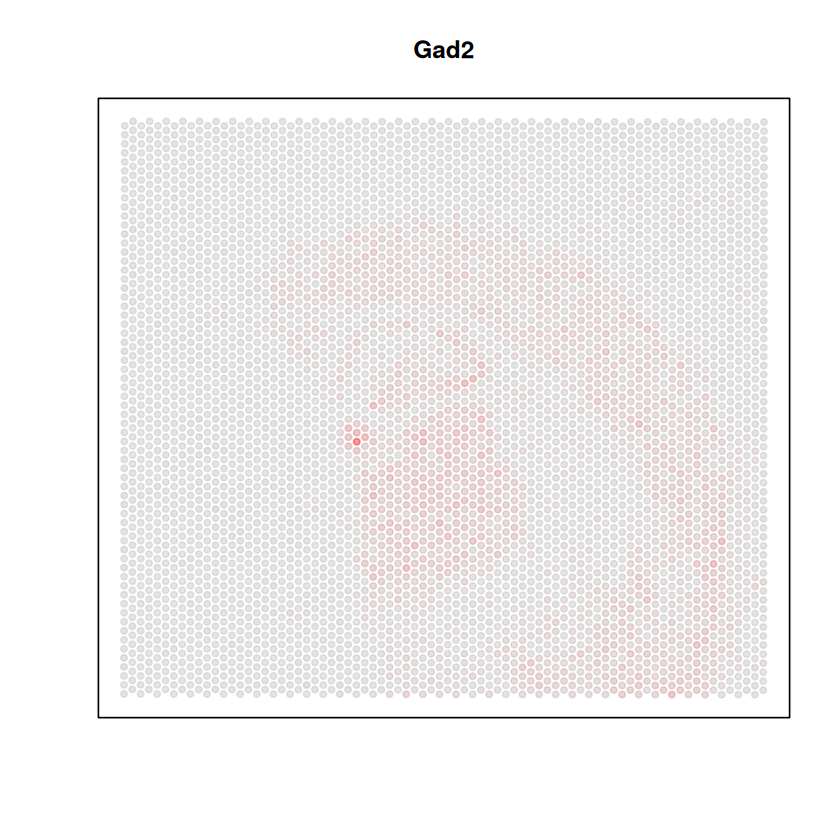

In [90]:
MERINGUE::plotEmbedding(pos, col=gexp[rownames(pos)],main=gg) 


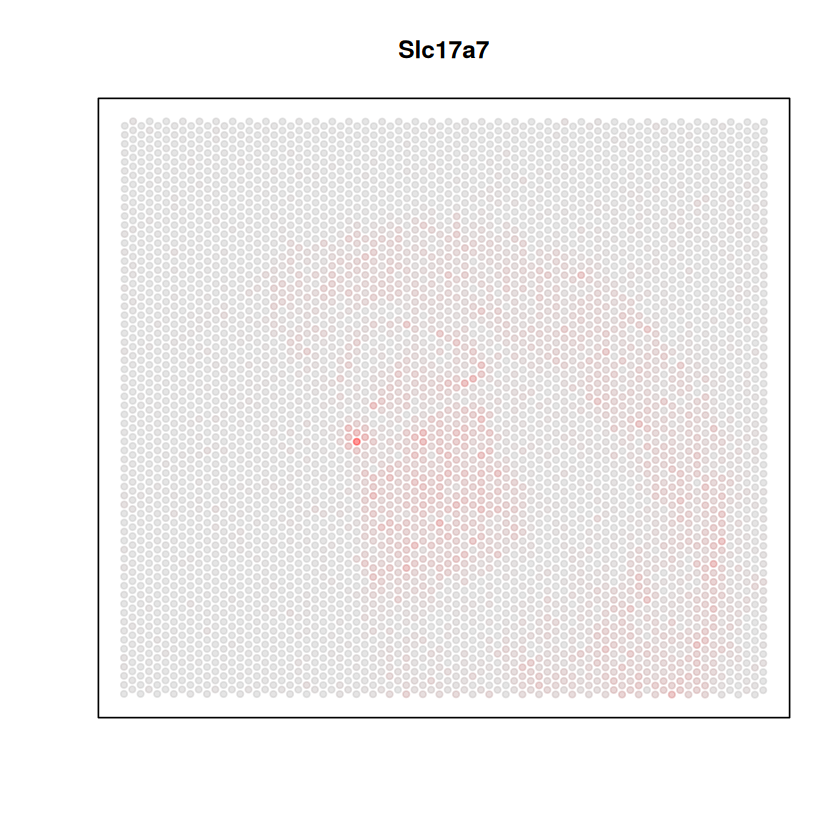

In [91]:
MERINGUE::plotEmbedding(pos, col=gexp[rownames(pos)],main=ggg) 


In [92]:
dim(countmat)

[1] 32589  4992

In [93]:
head(pos)

,V6,V5
,<int>,<int>
AAACAACGAATAGTTC-1,21457,16104
AAACAAGTATCTCCCA-1,8819,3643
AAACAATCTACTAGCA-1,20695,12188
AAACACCAATAACTGC-1,6563,15688
AAACAGAGCGACTCCT-1,17908,4792
AAACAGCTTTCAGAAG-1,10604,17134


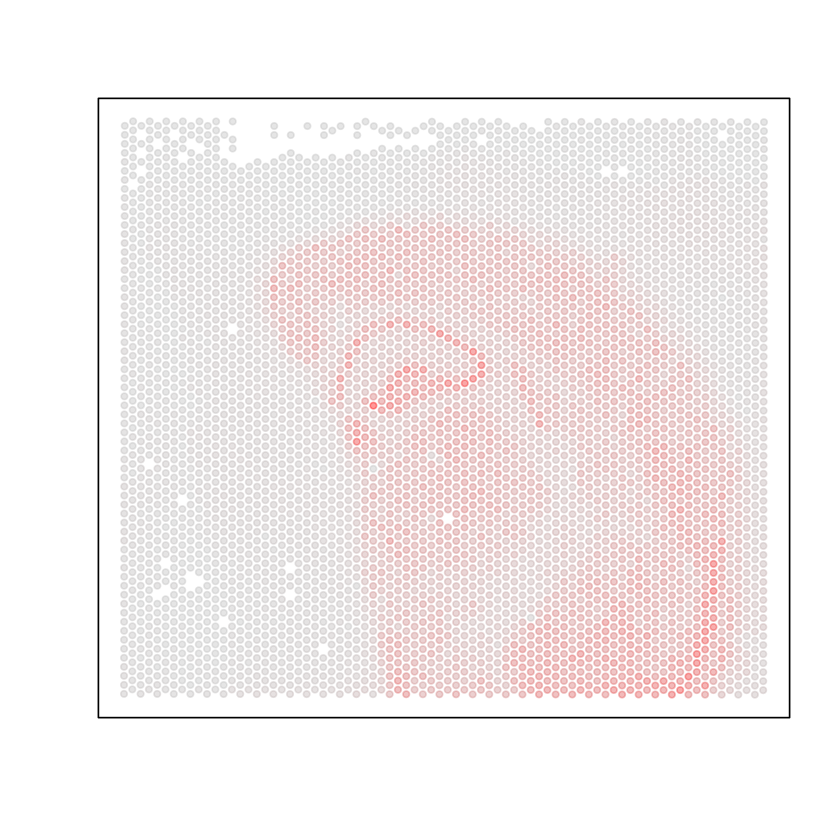

In [94]:
############ STdeconvolve
## remove pixels with too few genes
  counts <- cleanCounts(countmat, 
                         min.lib.size = 1000,
                         min.reads = 1000)
par(mfrow = c(1,1))
MERINGUE::plotEmbedding(pos[colnames(counts),], col=colSums(counts)) 


In [95]:
dim(countmat)

[1] 32589  4992

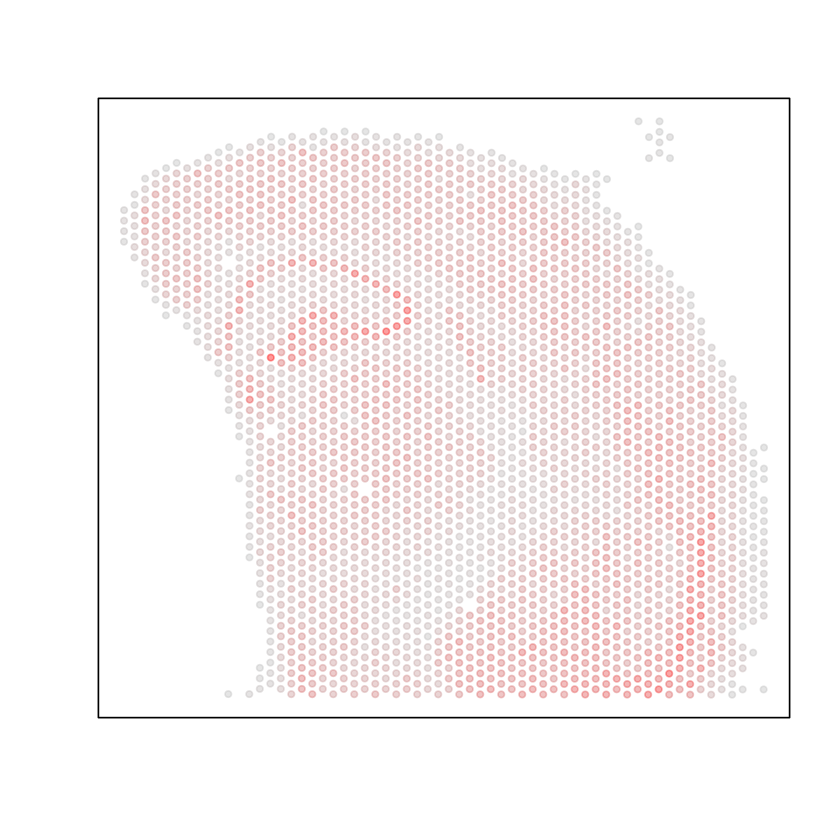

In [96]:
###change min

  counts <- cleanCounts(countmat, 
                         min.lib.size = 5000,
                         min.reads = 5000)
par(mfrow = c(1,1))
MERINGUE::plotEmbedding(pos[colnames(counts),], col=colSums(counts)) 

In [97]:
45:08

[1] 45 44 43 42 41 40 39 38 37 36 35 34 33 32 31 30 29 28 27 26 25 24 23 22 21
[26] 20 19 18 17 16 15 14 13 12 11 10  9  8

In [98]:
### chnange
cor.test(x,y)


ERROR: Error: object 'x' not found


In [100]:
dim(counts)

[1] 2100 2549

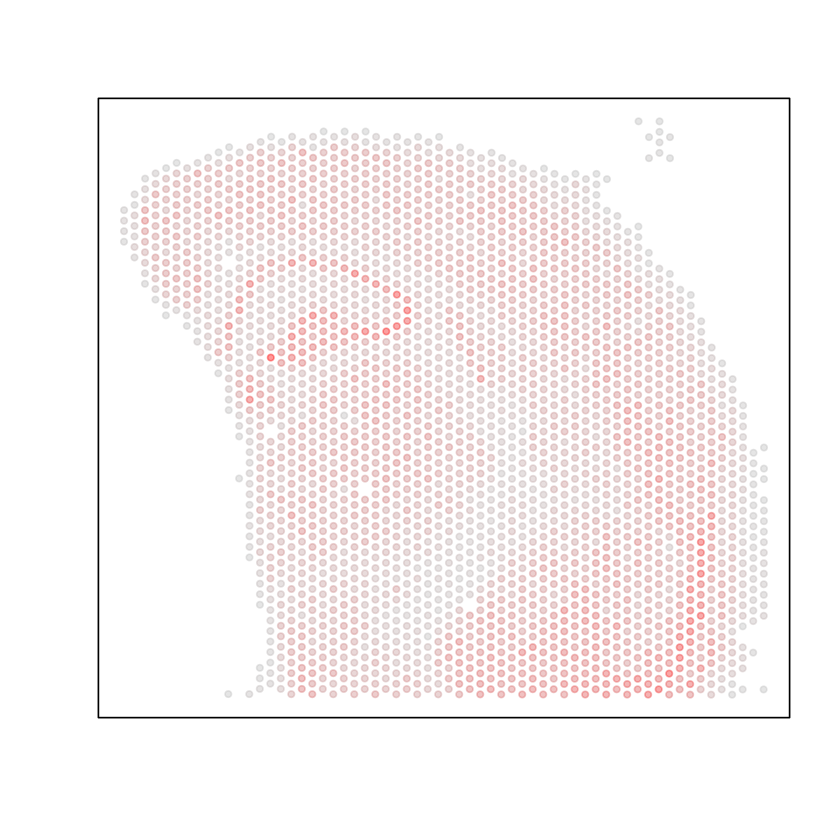

In [101]:
MERINGUE::plotEmbedding(pos[colnames(counts),], col=colSums(counts)) 


In [102]:
## feature select for genes
corpus <- restrictCorpus(counts, removeAbove=1.0, removeBelow = 0.05)
head(corpus)

Removing 47 genes present in 100% or more of pixels...

2053 genes remaining...

Removing 0 genes present in 5% or less of pixels...

2053 genes remaining...

Restricting to overdispersed genes with alpha = 0.05...

Calculating variance fit ...

Using gam with k=5...

476 overdispersed genes ... 

 Using top 1000 overdispersed genes.


 number of top overdispersed genes available: 476


  [[ suppressing 2549 column names ‘AAACAGAGCGACTCCT-1’, ‘AAACCACTACACAGAT-1’, ‘AAACCCGAACGAAATC-1’ ... ]]



6 x 2549 sparse Matrix of class "dgTMatrix"
                                                                               
Vxn            4 5  .  4 16 2 2  .  5 11  7  1  4 3 3  3 4 4 5 12 2 11 3  . . 8
Ogfrl1         1 3  1  1  3 1 .  3  3  3  4  6  3 . 2  5 . 1 1  6 1  1 .  9 8 1
2010300C02Rik  6 6  1  6  3 4 5  2  8 10 18  1  1 2 5  4 1 3 2  3 2 12 5  1 1 1
Igfbp5         . 3  1  .  1 . 1  1 10  5  3  5 10 . 3  8 3 . 2  3 .  . 2  1 2 2
Arpc2          8 1  1  4  2 2 .  .  4  4  3  7  1 . .  4 . 2 1  3 1  4 1  1 1 2
Ptprn         13 6 10 11  7 4 6 10  9 15 21 14  1 1 4 20 4 6 2 17 5 17 5 10 4 8
                                                                              
Vxn           1  1 .  9  1 18 4  9 5 3 1 11  7  9  7 8 2 2  7 1 4 33 7 2 23  3
Ogfrl1        2  4 3  5  4  7 2  3 3 . 1  2  7  1  5 3 1 .  2 . 1  8 1 2  4  4
2010300C02Rik 1  2 . 43  9  4 4  3 7 1 .  2  2 13  5 3 4 4  3 1 2  2 8 1 12  8
Igfbp5        2  9 1  9  4  3 2  2 . . 4  1  2  3  2 1 2 9  . 2 5  1 1 .  2  2
A

In [103]:
dim(corpus)

[1]  476 2549

Time to fit LDA models was 14.8 mins

Computing perplexity for each fitted model...

Time to compute perplexities was 0 mins

Getting predicted cell-types at low proportions...

Time to compute cell-types at low proportions was 0 mins

Plotting...

Warning message in ggplot2::geom_point(ggplot2::aes(y = rareCtsAdj, x = K), col = "blue", :
“Ignoring unknown parameters: `linewidth`”
Warning message in ggplot2::geom_point(ggplot2::aes(y = perplexAdj, x = K), col = "red", :
“Ignoring unknown parameters: `linewidth`”
`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?
`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?


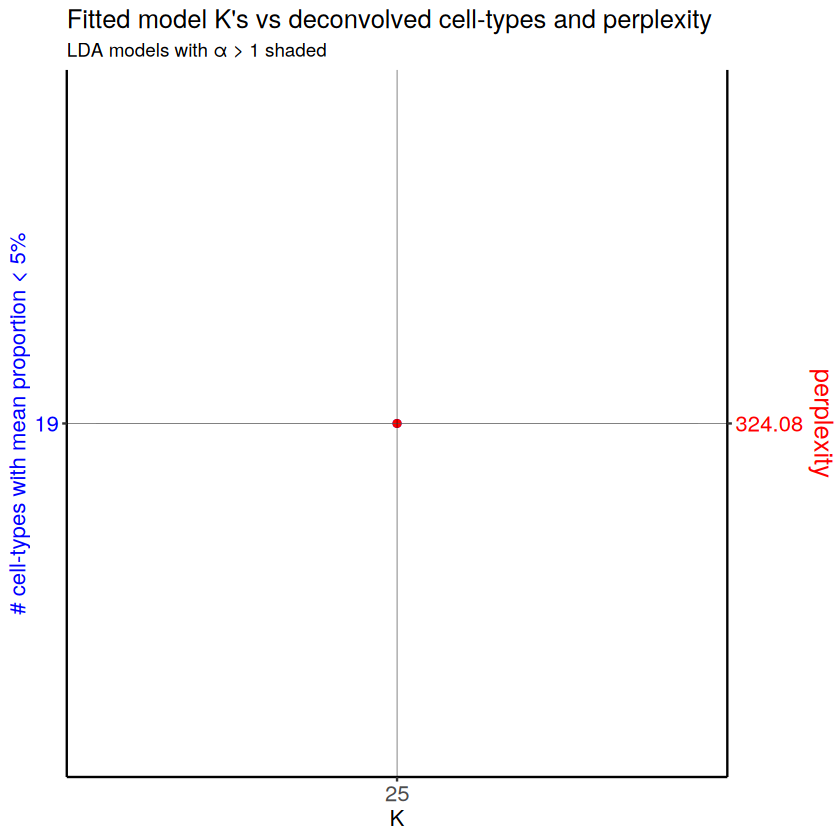

In [104]:
## choose optimal number of cell-types
ldas <- fitLDA(t(as.matrix(corpus)), Ks = c(25))

In [105]:
dim(mbrain_obj)

[1] 11575  4992

In [106]:
dim(mbrain_obj[,colnames(decont_obj)])

[1] 11575  2264

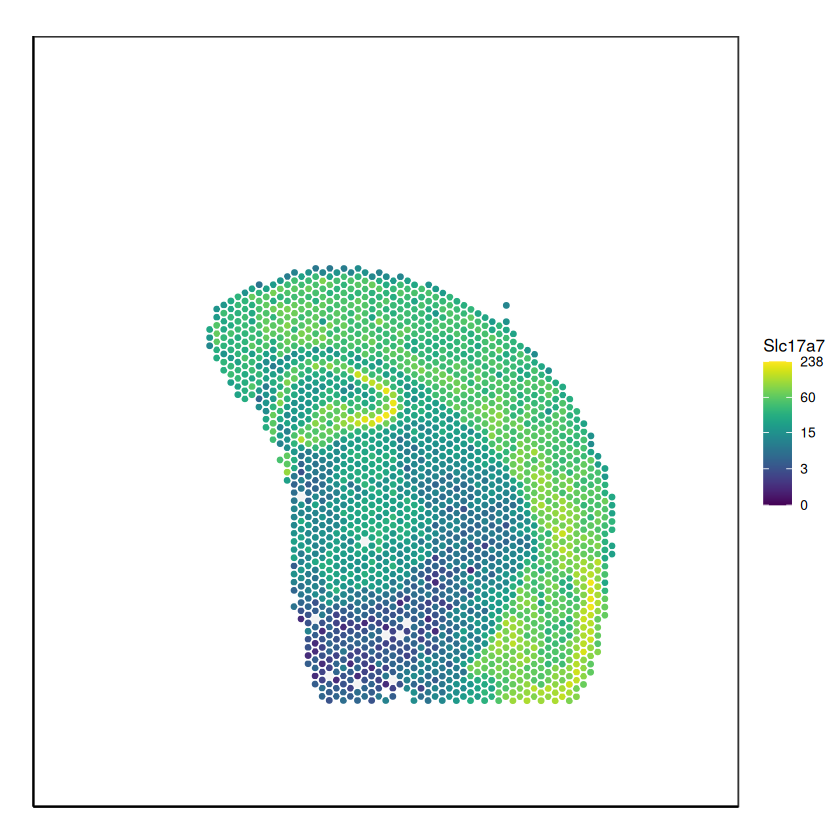

In [107]:
visualizeHeatmap(mbrain_obj[,colnames(decont_obj)],ggg)

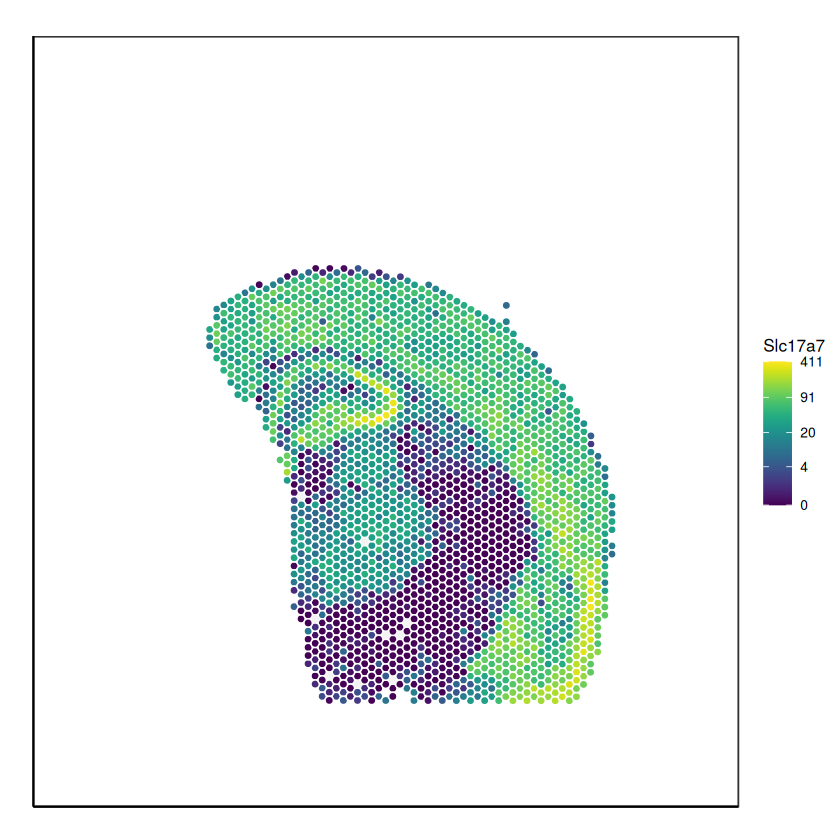

In [108]:
visualizeHeatmap(decont_obj,ggg)

In [109]:
orginal <- mbrain_obj[g,colnames(decont_obj)]

In [110]:
new <- decont_obj[g,]

In [111]:
x <- orginal@assays@data$raw
y<- new@assays@data$decont

In [112]:
dim(x)
dim(y)

[1]    1 2264

[1]    1 2264

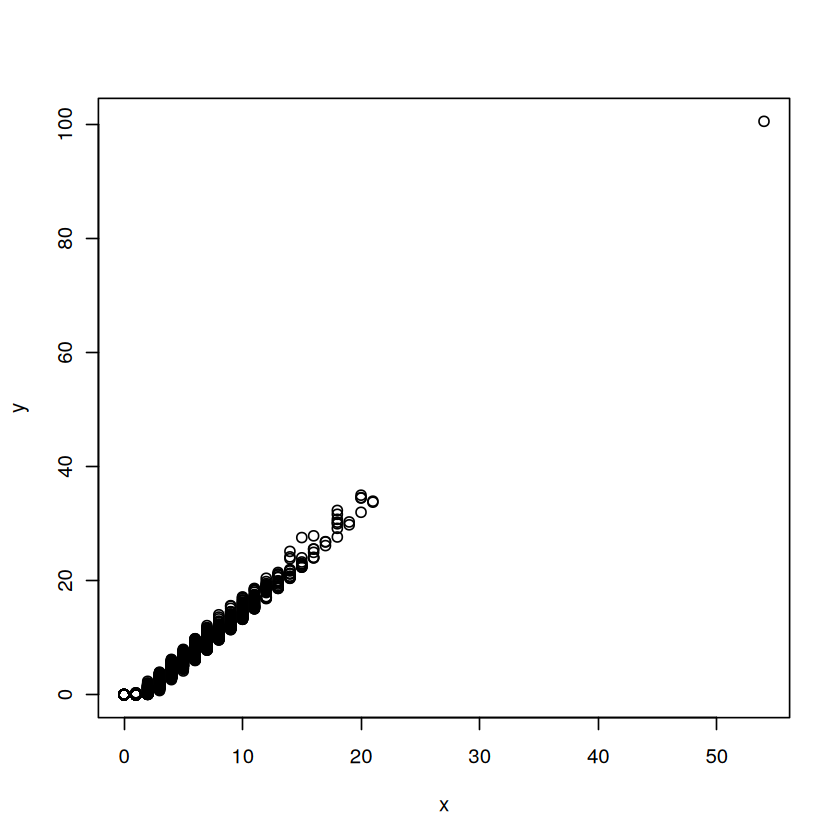

In [113]:
plot(x,y)

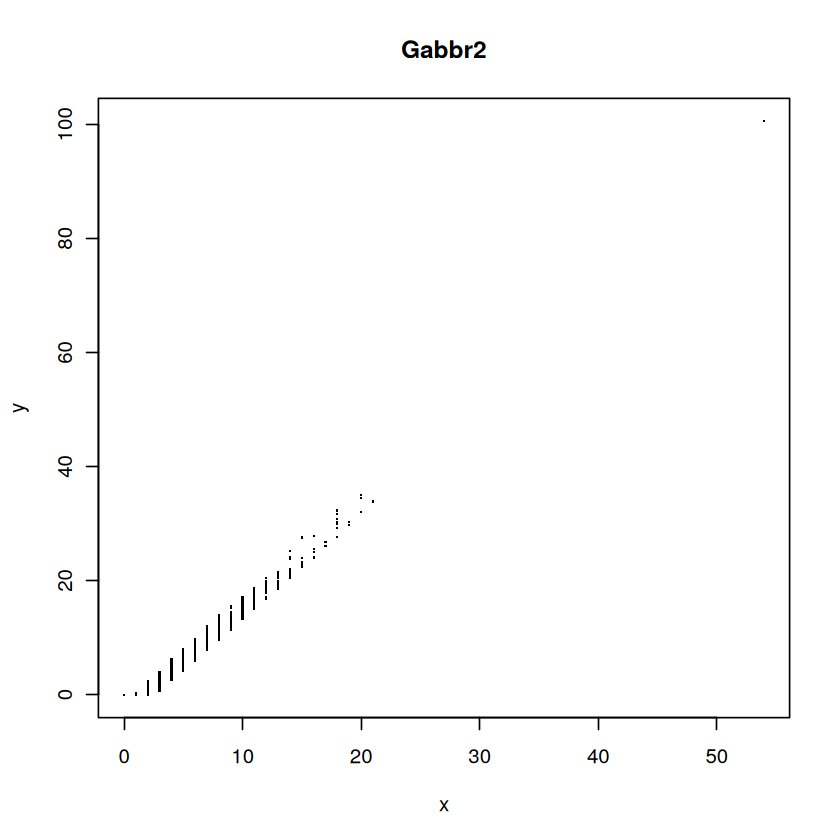

In [114]:
plot(x,y,main=g,pch = ".")

In [115]:
cor.test(x,y)

ERROR: Error in cor.test.default(x, y): 'x' must be a numeric vector


In [117]:
cor.test(as.numeric(x),as.numeric(y))


	Pearson's product-moment correlation

data:  as.numeric(x) and as.numeric(y)
t = 281.05, df = 2262, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9847867 0.9870842
sample estimates:
      cor 
0.9859821 


In [118]:
#cor.test(x,y) show super corealation before and after cleaning

In [119]:
###########STdeconvolve

cd <- decont_obj@assays@data$decont
class(cd)
dim(cd)

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

[1] 11575  2264

In [120]:
counts2 <- cleanCounts(cd, min.lib.size=10^3.75, min.reads=2000,)


In [121]:
dim(counts2)

[1] 5844 2238

In [122]:
  corpus2 <- restrictCorpus(counts2, removeAbove=1.0, removeBelow = 0.05)
  head(corpus)

Removing 88 genes present in 100% or more of pixels...

5756 genes remaining...

Removing 0 genes present in 5% or less of pixels...

5756 genes remaining...

Restricting to overdispersed genes with alpha = 0.05...

Calculating variance fit ...

Using gam with k=5...

1063 overdispersed genes ... 

 Using top 1000 overdispersed genes.


  [[ suppressing 2549 column names ‘AAACAGAGCGACTCCT-1’, ‘AAACCACTACACAGAT-1’, ‘AAACCCGAACGAAATC-1’ ... ]]



6 x 2549 sparse Matrix of class "dgTMatrix"
                                                                               
Vxn            4 5  .  4 16 2 2  .  5 11  7  1  4 3 3  3 4 4 5 12 2 11 3  . . 8
Ogfrl1         1 3  1  1  3 1 .  3  3  3  4  6  3 . 2  5 . 1 1  6 1  1 .  9 8 1
2010300C02Rik  6 6  1  6  3 4 5  2  8 10 18  1  1 2 5  4 1 3 2  3 2 12 5  1 1 1
Igfbp5         . 3  1  .  1 . 1  1 10  5  3  5 10 . 3  8 3 . 2  3 .  . 2  1 2 2
Arpc2          8 1  1  4  2 2 .  .  4  4  3  7  1 . .  4 . 2 1  3 1  4 1  1 1 2
Ptprn         13 6 10 11  7 4 6 10  9 15 21 14  1 1 4 20 4 6 2 17 5 17 5 10 4 8
                                                                              
Vxn           1  1 .  9  1 18 4  9 5 3 1 11  7  9  7 8 2 2  7 1 4 33 7 2 23  3
Ogfrl1        2  4 3  5  4  7 2  3 3 . 1  2  7  1  5 3 1 .  2 . 1  8 1 2  4  4
2010300C02Rik 1  2 . 43  9  4 4  3 7 1 .  2  2 13  5 3 4 4  3 1 2  2 8 1 12  8
Igfbp5        2  9 1  9  4  3 2  2 . . 4  1  2  3  2 1 2 9  . 2 5  1 1 .  2  2
A

In [123]:
dim(corpus2)

[1] 1000 2238

In [124]:
class(cd)

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

In [125]:
## choose optimal number of cell-types
ldas2 <- fitLDA(t(as.matrix(corpus2)), Ks = c(25))

ERROR: Error in fitLDA(t(as.matrix(corpus2)), Ks = c(25)): `counts` must contain integer gene counts


In [127]:
##make integer counts
cd <- floor(cd)

In [129]:
class(cd)

[1] "dgCMatrix"
attr(,"package")
[1] "Matrix"

In [131]:
counts2 <- cleanCounts(cd, min.lib.size=10^3.75, min.reads=2000,)

In [132]:
corpus2 <- restrictCorpus(counts2, removeAbove=1.0, removeBelow = 0.05)
head(corpus)

Removing 1 genes present in 100% or more of pixels...

4906 genes remaining...

Removing 0 genes present in 5% or less of pixels...

4906 genes remaining...

Restricting to overdispersed genes with alpha = 0.05...

Calculating variance fit ...

Using gam with k=5...

1511 overdispersed genes ... 

 Using top 1000 overdispersed genes.


  [[ suppressing 2549 column names ‘AAACAGAGCGACTCCT-1’, ‘AAACCACTACACAGAT-1’, ‘AAACCCGAACGAAATC-1’ ... ]]



6 x 2549 sparse Matrix of class "dgTMatrix"
                                                                               
Vxn            4 5  .  4 16 2 2  .  5 11  7  1  4 3 3  3 4 4 5 12 2 11 3  . . 8
Ogfrl1         1 3  1  1  3 1 .  3  3  3  4  6  3 . 2  5 . 1 1  6 1  1 .  9 8 1
2010300C02Rik  6 6  1  6  3 4 5  2  8 10 18  1  1 2 5  4 1 3 2  3 2 12 5  1 1 1
Igfbp5         . 3  1  .  1 . 1  1 10  5  3  5 10 . 3  8 3 . 2  3 .  . 2  1 2 2
Arpc2          8 1  1  4  2 2 .  .  4  4  3  7  1 . .  4 . 2 1  3 1  4 1  1 1 2
Ptprn         13 6 10 11  7 4 6 10  9 15 21 14  1 1 4 20 4 6 2 17 5 17 5 10 4 8
                                                                              
Vxn           1  1 .  9  1 18 4  9 5 3 1 11  7  9  7 8 2 2  7 1 4 33 7 2 23  3
Ogfrl1        2  4 3  5  4  7 2  3 3 . 1  2  7  1  5 3 1 .  2 . 1  8 1 2  4  4
2010300C02Rik 1  2 . 43  9  4 4  3 7 1 .  2  2 13  5 3 4 4  3 1 2  2 8 1 12  8
Igfbp5        2  9 1  9  4  3 2  2 . . 4  1  2  3  2 1 2 9  . 2 5  1 1 .  2  2
A

Time to fit LDA models was 21.7 mins

Computing perplexity for each fitted model...

Time to compute perplexities was 0 mins

Getting predicted cell-types at low proportions...

Time to compute cell-types at low proportions was 0 mins

Plotting...

Warning message in ggplot2::geom_point(ggplot2::aes(y = rareCtsAdj, x = K), col = "blue", :
“Ignoring unknown parameters: `linewidth`”
Warning message in ggplot2::geom_point(ggplot2::aes(y = perplexAdj, x = K), col = "red", :
“Ignoring unknown parameters: `linewidth`”
`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?
`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?


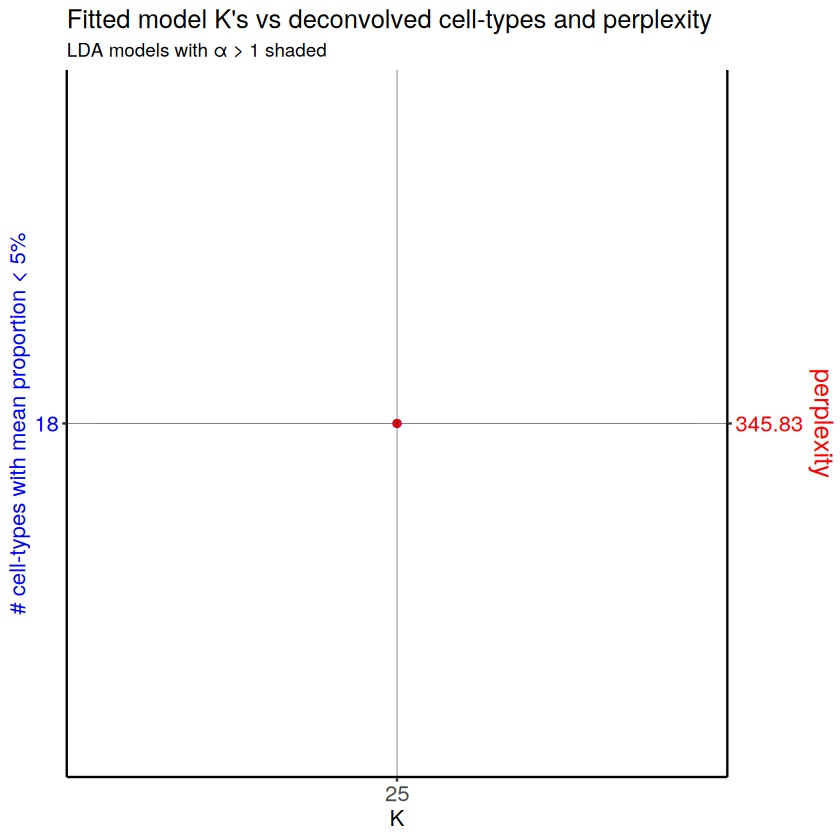

In [133]:
ldas2 <- fitLDA(t(as.matrix(corpus2)), Ks = c(25))

In [135]:
optLDA <- optimalModel(models = ldas, opt = "25")


In [137]:
class(optLDA)

[1] "LDA_VEM"
attr(,"package")
[1] "topicmodels"

In [139]:
optimalModel

function (models, opt) 
{
    if (opt == "kneed") {
        m <- models$models[[which(sapply(models$models, slot, 
            "k") == models$kneedOptK)]]
    }
    else if (opt == "min") {
        m <- models$models[[which(sapply(models$models, slot, 
            "k") == models$minOptK)]]
    }
    else if (opt == "proportion") {
        m <- models$models[[which(sapply(models$models, slot, 
            "k") == models$ctPropOptK)]]
    }
    else if (opt %in% sapply(models$models, slot, "k")) {
        m <- models$models[[which(sapply(models$models, slot, 
            "k") == opt)]]
    }
    else {
        stop("`opt` must be either 'kneed',  'min', 'proportion', or integer of a fitted K")
    }
    return(m)
}
<bytecode: 0x5891d86b79b8>
<environment: namespace:STdeconvolve>

In [141]:
results <- getBetaTheta(optLDA, perc.filt = 0.05, betaScale = 1000)

Filtering out cell-types in pixels that contribute less than 0.05 of the pixel proportion.




In [143]:
deconProp <- results$theta
deconGexp <- results$beta

In [276]:
dim(deconProp)
dim(deconGexp)

[1] 2549   25

[1]  25 476

In [278]:
dim(pos)

[1] 4992    2

In [145]:
head(deconProp)

,1,2,3,4,5,6,7,8,9,10,⋯,16,17,18,19,20,21,22,23,24,25
AAACAGAGCGACTCCT-1,0,0,0.0000000,0,0.3030455,0.00000000,0.0000000,0.00000000,0.10751149,0.27819980,⋯,0.0000000,0.00000000,0.07036824,0.0000000,0.0000000,0,0.06258699,0.06349876,0.00000000,0.00000000
AAACCACTACACAGAT-1,0,0,0.0000000,0,0.3359897,0.06797027,0.0000000,0.00000000,0.08414846,0.19274951,⋯,0.0000000,0.14503547,0.12031163,0.0000000,0.0000000,0,0.05379491,0.00000000,0.00000000,0.00000000
AAACCCGAACGAAATC-1,0,0,0.0000000,0,0.0000000,0.00000000,0.2242207,0.00000000,0.00000000,0.00000000,⋯,0.3412509,0.00000000,0.00000000,0.0000000,0.3653405,0,0.00000000,0.00000000,0.00000000,0.06918786
AAACCGGGTAGGTACC-1,0,0,0.1759473,0,0.0000000,0.00000000,0.0000000,0.09463597,0.00000000,0.08231267,⋯,0.0000000,0.00000000,0.13029942,0.0000000,0.0000000,0,0.00000000,0.00000000,0.10895072,0.00000000
AAACCGTTCGTCCAGG-1,0,0,0.0000000,0,0.0000000,0.05991100,0.0000000,0.00000000,0.13593914,0.00000000,⋯,0.0000000,0.06674207,0.08805063,0.2005309,0.0533002,0,0.07897135,0.00000000,0.05306499,0.00000000
AAACGAAGAACATACC-1,0,0,0.0000000,0,0.1641802,0.00000000,0.0000000,0.15833095,0.00000000,0.21168532,⋯,0.0000000,0.00000000,0.12848446,0.0000000,0.0000000,0,0.00000000,0.00000000,0.23205888,0.00000000


Plotting scatterpies for 2549 pixels with 25 cell-types...this could take a while if the dataset is large.




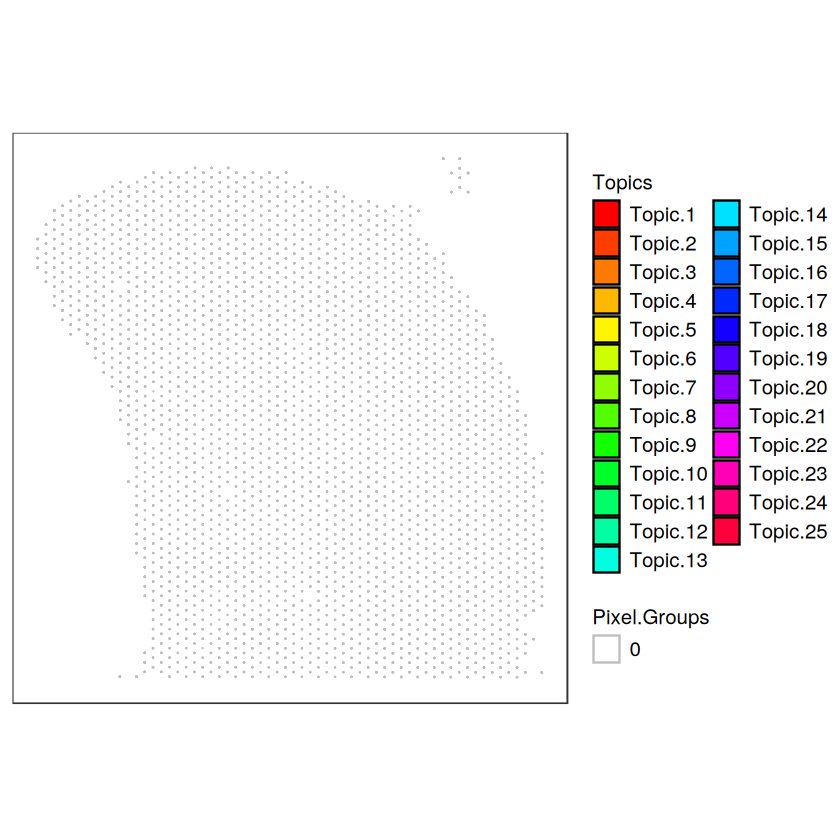

In [147]:
  ## visualize deconvolved cell-type proportions
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp,ppos, r=0.4)

In [322]:
head(ppos)

,x,y
,<dbl>,<dbl>
AAACAGAGCGACTCCT-1,391.5173,104.7661
AAACCCGAACGAAATC-1,220.3323,38.3909
AAACCGGGTAGGTACC-1,237.2540,314.3201
AAACCGTTCGTCCAGG-1,182.0070,269.9825
AAACGAAGAACATACC-1,435.8111,199.8688
AAACGAGACGGTTGAT-1,275.6887,152.4923


Filtering out cell-types in pixels that contribute less than 0.05 of the pixel proportion.


Plotting scatterpies for 2176 pixels with 25 cell-types...this could take a while if the dataset is large.




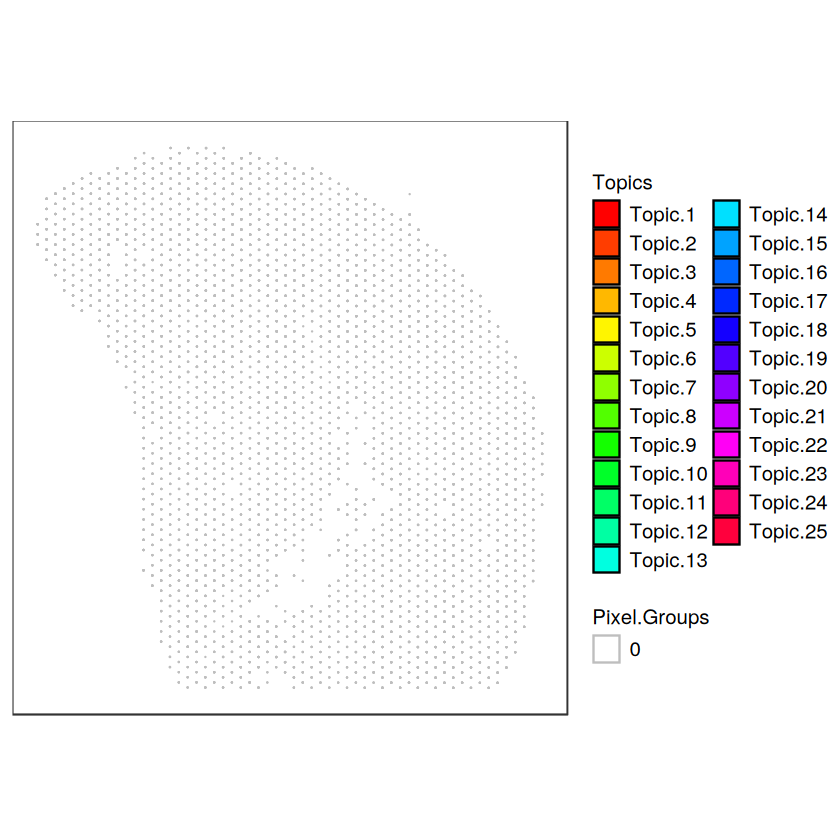

In [148]:
## again choose optimal number of cell-types
optLDA2 <- optimalModel(models = ldas2, opt = "25")
results2 <- getBetaTheta(optLDA2, perc.filt = 0.05, betaScale = 1000)
deconProp2 <- results2$theta
deconGexp2 <- results2$beta
ppos <-  pos[rownames(deconProp2),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp,ppos, r=0.4)

In [300]:
head(results2)


,Ttr,Pmch,Hcrt,Hbb-bs,Ptgds,Hba-a2,Enpp2,Tac2,Cartpt,Nwd2,⋯,Zc3h13,Tacc2,Prkcb,Nt5c,Tcerg1,Cers4,Parva,Nop53,Pak7,Dnaja4
1,3.902712e-02,2.819449e-03,1.000837e-03,5.054499e+02,2.253687e-02,2.319814e+02,6.450548e-01,1.257138e+00,1.813681e-01,6.918500e-01,⋯,0.261885722,0.11846283,0.4894696,0.17472755,0.05007921,0.07742710,0.2646303356,0.12910166,6.794554e-07,0.05689757
2,1.244657e-14,2.676688e-11,4.213838e-19,1.384619e-06,2.614966e-05,1.913916e-03,3.917127e-02,1.299167e-09,5.297928e-07,5.836268e-02,⋯,0.320931950,0.28186928,7.5410447,0.35266431,0.01178818,0.34291958,0.3422728352,0.02557146,1.732406e-01,0.30626848
3,2.133051e-15,3.795703e-09,2.108959e-18,7.214333e-07,5.802470e-05,5.269351e-02,8.150899e-02,1.235727e-06,1.738682e-03,1.474282e-01,⋯,0.788965058,0.10117040,0.9744710,0.75201163,0.60905685,0.20167201,0.0365545212,0.11467376,1.204775e-01,0.19893167
4,7.148231e-15,6.360135e-10,1.668895e-22,1.006983e-05,1.440999e-04,8.926119e-02,8.214118e-02,4.011851e-02,3.429489e-07,8.240309e-01,⋯,0.002037259,0.50450336,5.8707919,0.18975248,0.52330094,0.29541706,0.0145001931,0.19621058,1.520459e-01,0.53770086
5,1.715463e-05,1.613374e+02,4.347195e+01,6.366543e-11,4.573985e-06,4.097559e-07,8.875608e-01,8.039025e+00,6.823299e+00,3.241690e+00,⋯,0.244855736,0.16135811,0.8743559,0.37307822,0.25432368,0.67127142,0.3296669519,0.19567102,2.187054e-01,0.06882444
6,2.731705e-14,1.850255e-05,1.967573e-17,1.466463e-05,7.262994e-04,5.093042e-02,1.221118e+00,3.654702e-03,8.352183e-03,1.976162e+00,⋯,0.199350645,0.35820666,0.3362732,0.13331078,0.12052199,0.30541182,0.1043047973,0.17721803,3.101215e-02,0.18753977
7,5.590412e-14,1.936127e-06,5.524941e-02,6.964108e-07,1.276342e-03,4.425815e-06,1.375959e-01,6.620180e+00,4.105838e-01,1.207016e-03,⋯,0.187688575,0.34138281,1.5608096,0.46312846,0.31916374,0.09232372,0.2083662817,0.34155590,1.598203e-01,0.15543217
8,5.041032e-07,8.181025e-12,1.210214e-07,1.365319e-01,2.300497e-01,2.060106e-01,1.479392e-01,1.875440e-06,1.554009e+00,3.589356e-02,⋯,0.622997438,0.29953457,0.7354555,0.14230222,0.28511236,0.90027246,0.2231518930,0.26729036,1.608762e-01,0.09453436
9,1.083716e-07,1.253502e-09,5.016872e-10,1.522701e-01,6.737334e-01,1.964139e-01,2.776812e-01,1.042109e-02,5.832772e-01,4.194673e-01,⋯,0.244535580,0.94722272,0.1365493,1.20557889,0.81200878,0.80328276,0.8940841204,0.48092882,1.206596e-01,0.44886823
10,6.456811e-05,1.308629e-10,1.009077e-08,4.374852e+00,3.416379e+02,2.005023e+00,1.993402e+00,1.846667e-02,2.835325e-02,1.858132e-02,⋯,0.086640422,0.23729022,0.3629855,0.03489676,0.26703562,0.16730883,1.0343062267,0.15532256,4.213938e-02,0.18721336


In [350]:
 ## visualize deconvolved cell-type proportions
pos.info <- mbrain_slide_info$slide
pos <- pos.info[, c('imagerow', 'imagecol')]
rownames(pos) <- pos.info$barcode


pos <- pos[, c(2,1)]
pos[,2] <- -pos[,2] 
pos[,2] <- pos[,2] - min(pos[,2])
head(pos)



par(mfrow = c(1,1))
ppos <-  pos[rownames(deconProp2),]
colnames(ppos) <- c('x','y')
par(mfrow = c(1,1))



,imagecol,imagerow
,<dbl>,<dbl>
ACGCCTGACACGCGCT-1,469.1954,402.8203
TACCGATCCAACACTT-1,463.6642,399.6721
ATTAAAGCGGACGAGC-1,469.1736,396.4801
GATAAGGGACGATTAG-1,463.6423,393.3100
GTGCAAATCACCAATA-1,469.1736,390.1399
TGTTGGCTGGCGGAAG-1,463.6423,386.9698


Plotting scatterpies for 2176 pixels with 25 cell-types...this could take a while if the dataset is large.




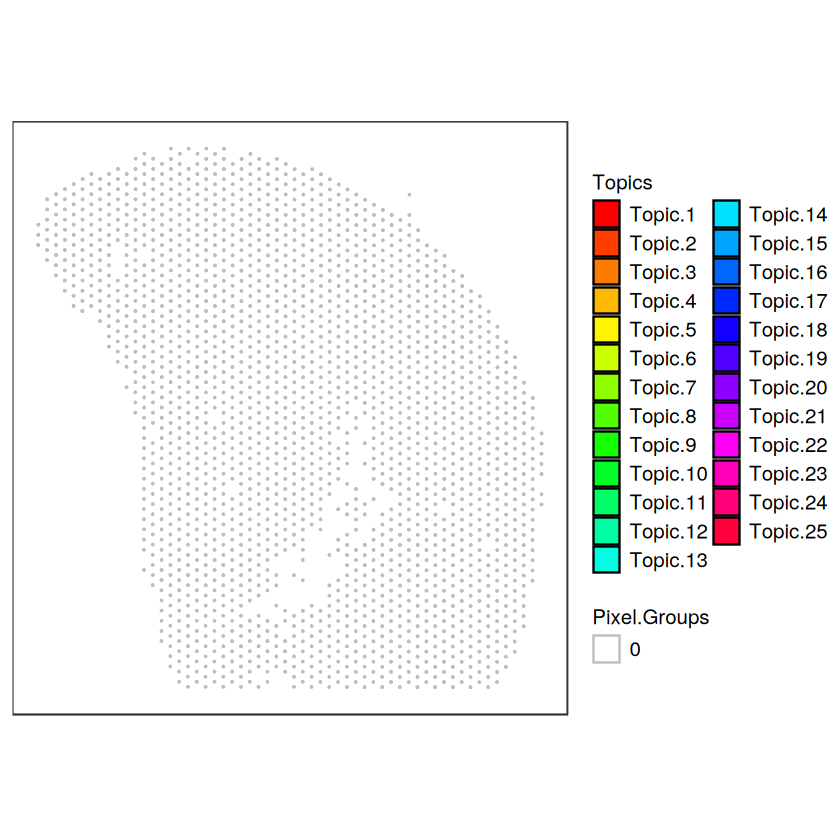

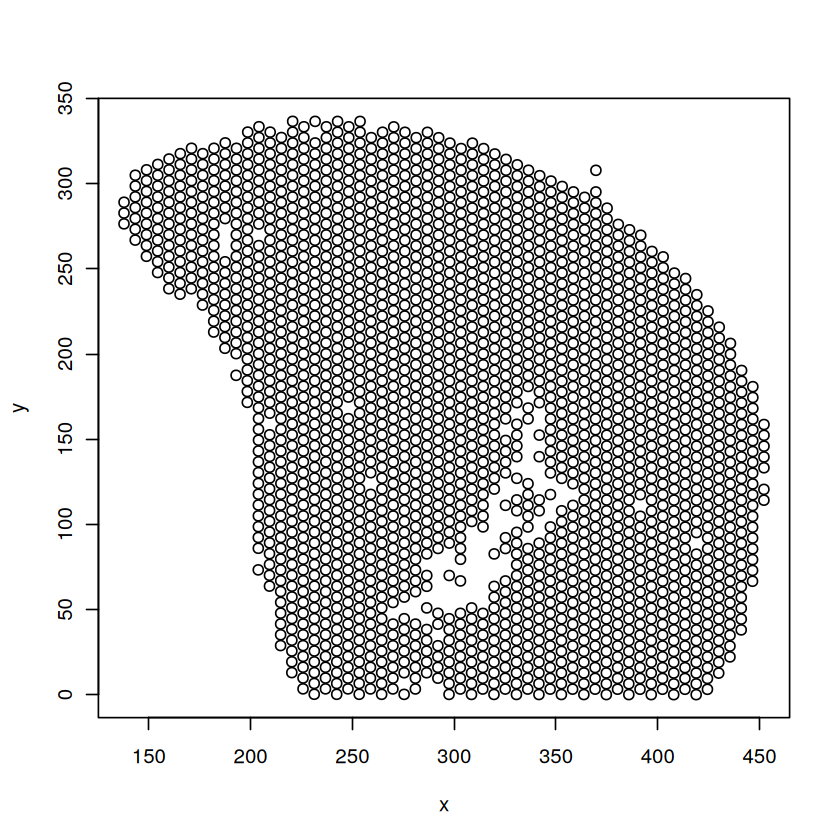

In [352]:
vizAllTopics(deconProp,ppos, r=0.4)

plot(ppos)

In [354]:
dim(ppos)

[1] 2176    2

In [356]:
colnames(ppos)

[1] "x" "y"

In [360]:
head(ppos)

,x,y
,<dbl>,<dbl>
AAACAGAGCGACTCCT-1,391.5173,104.7661
AAACCCGAACGAAATC-1,220.3323,38.3909
AAACCGGGTAGGTACC-1,237.2540,314.3201
AAACCGTTCGTCCAGG-1,182.0070,269.9825
AAACGAAGAACATACC-1,435.8111,199.8688
AAACGAGACGGTTGAT-1,275.6887,152.4923


In [362]:
head(pos)

,imagecol,imagerow
,<dbl>,<dbl>
ACGCCTGACACGCGCT-1,469.1954,402.8203
TACCGATCCAACACTT-1,463.6642,399.6721
ATTAAAGCGGACGAGC-1,469.1736,396.4801
GATAAGGGACGATTAG-1,463.6423,393.3100
GTGCAAATCACCAATA-1,469.1736,390.1399
TGTTGGCTGGCGGAAG-1,463.6423,386.9698


In [364]:
dim(deconProp2)

[1] 2176   25

In [344]:
dim(cd)

[1] 11575  2264

In [366]:
head(ppos)

,x,y
,<dbl>,<dbl>
AAACAGAGCGACTCCT-1,391.5173,104.7661
AAACCCGAACGAAATC-1,220.3323,38.3909
AAACCGGGTAGGTACC-1,237.2540,314.3201
AAACCGTTCGTCCAGG-1,182.0070,269.9825
AAACGAAGAACATACC-1,435.8111,199.8688
AAACGAGACGGTTGAT-1,275.6887,152.4923


In [378]:
ppp <- ppos

colnames(ppp) <- c('x','y')

In [380]:
head(ppp)

,x,y
,<dbl>,<dbl>
AAACAGAGCGACTCCT-1,391.5173,104.7661
AAACCCGAACGAAATC-1,220.3323,38.3909
AAACCGGGTAGGTACC-1,237.2540,314.3201
AAACCGTTCGTCCAGG-1,182.0070,269.9825
AAACGAAGAACATACC-1,435.8111,199.8688
AAACGAGACGGTTGAT-1,275.6887,152.4923


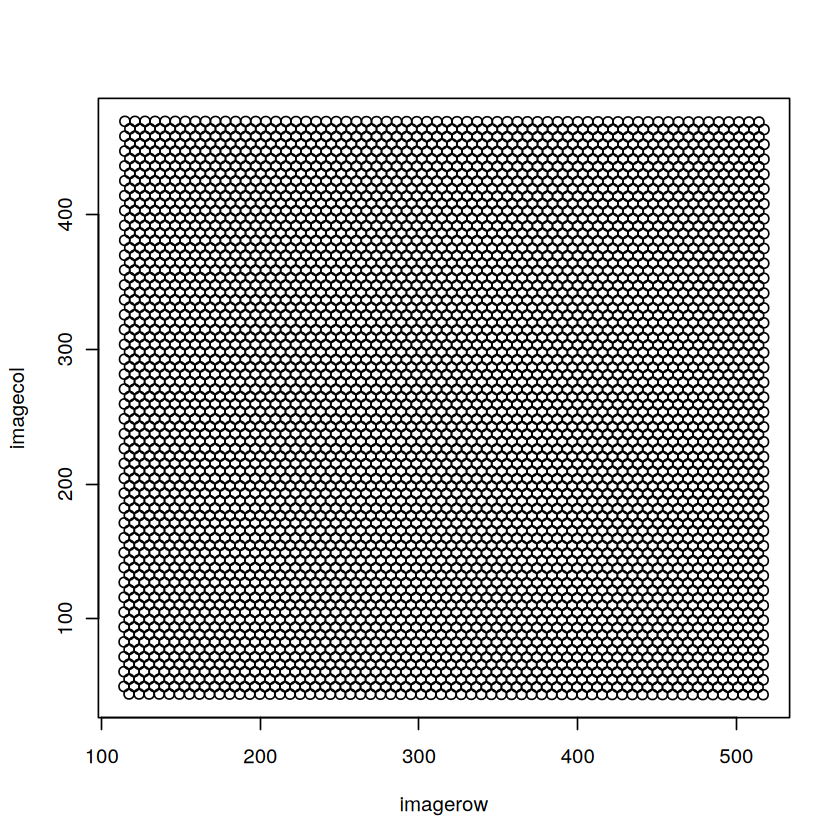

In [152]:
plot(pos)

In [155]:
head(ppos)

,x,y
,<dbl>,<dbl>
AAACAGAGCGACTCCT-1,412.7678,391.5173
AAACCCGAACGAAATC-1,479.1430,220.3323
AAACCGGGTAGGTACC-1,203.2138,237.2540
AAACCGTTCGTCCAGG-1,247.5514,182.0070
AAACGAAGAACATACC-1,317.6651,435.8111
AAACGAGACGGTTGAT-1,365.0415,275.6887


,imagecol,imagerow
,<dbl>,<dbl>
ACGCCTGACACGCGCT-1,469.1954,402.8203
TACCGATCCAACACTT-1,463.6642,399.6721
ATTAAAGCGGACGAGC-1,469.1736,396.4801
GATAAGGGACGATTAG-1,463.6423,393.3100
GTGCAAATCACCAATA-1,469.1736,390.1399
TGTTGGCTGGCGGAAG-1,463.6423,386.9698


,x,y
,<dbl>,<dbl>
AAACAGAGCGACTCCT-1,391.5173,104.7661
AAACCCGAACGAAATC-1,220.3323,38.3909
AAACCGGGTAGGTACC-1,237.2540,314.3201
AAACCGTTCGTCCAGG-1,182.0070,269.9825
AAACGAAGAACATACC-1,435.8111,199.8688
AAACGAGACGGTTGAT-1,275.6887,152.4923


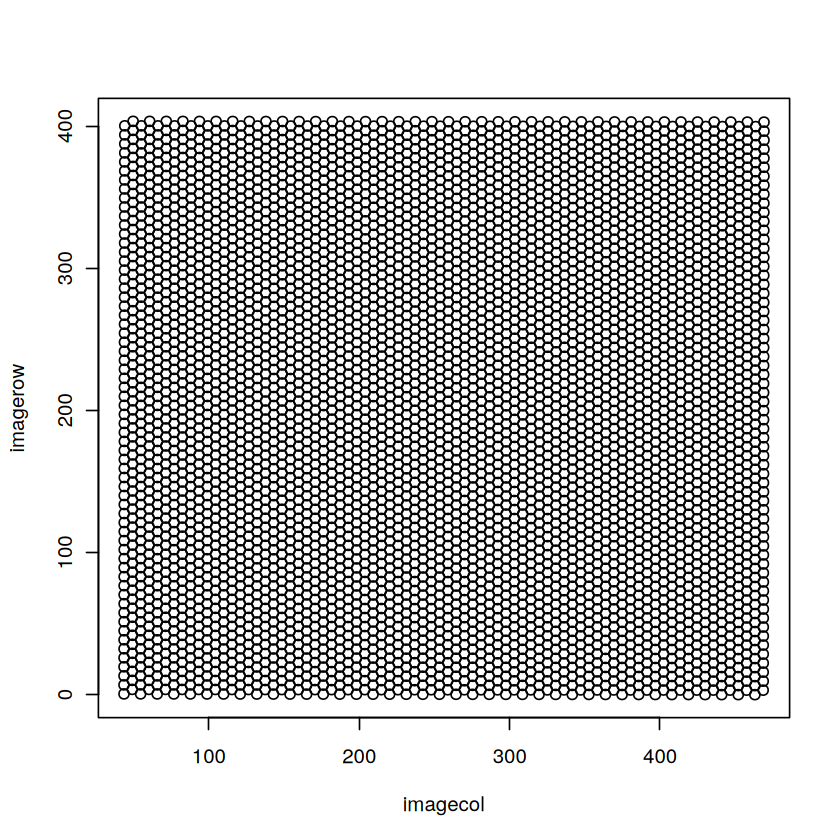

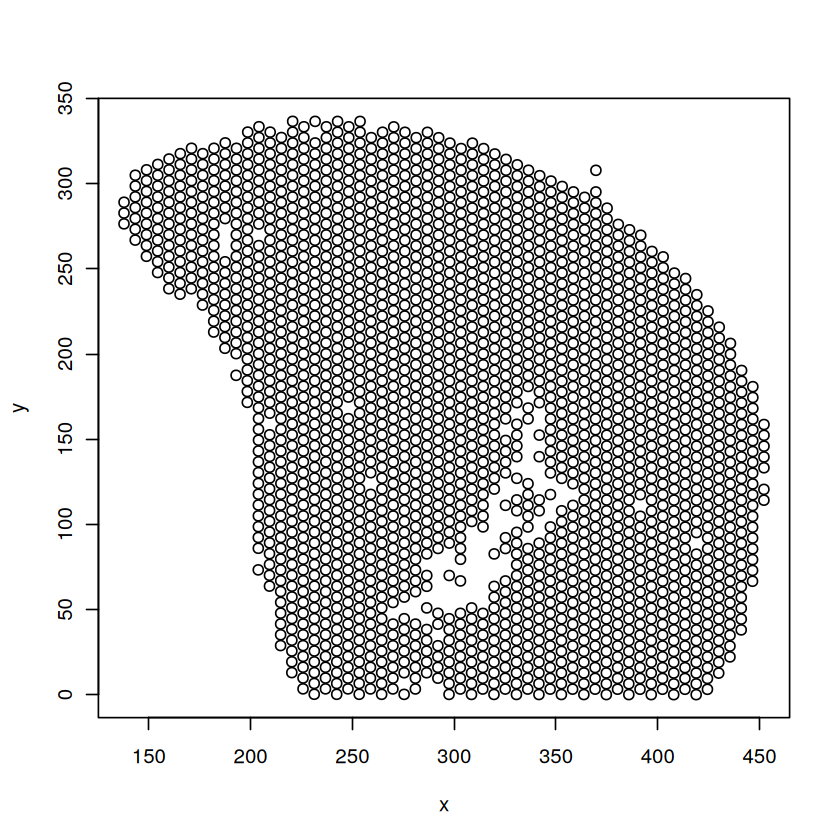

In [156]:
 ## fix position
  pos <- pos[, c(2,1)]
  pos[,2] <- -pos[,2] 
  pos[,2] <- pos[,2] - min(pos[,2])
  head(pos)
  par(mfrow=c(1,1))
  plot(pos)
  ppos2 <- pos[rownames(deconProp2),]
  colnames(ppos2) <- c('x', 'y')
  head(ppos2)
  par(mfrow=c(1,1))
  plot(ppos2)

Plotting scatterpies for 2176 pixels with 25 cell-types...this could take a while if the dataset is large.




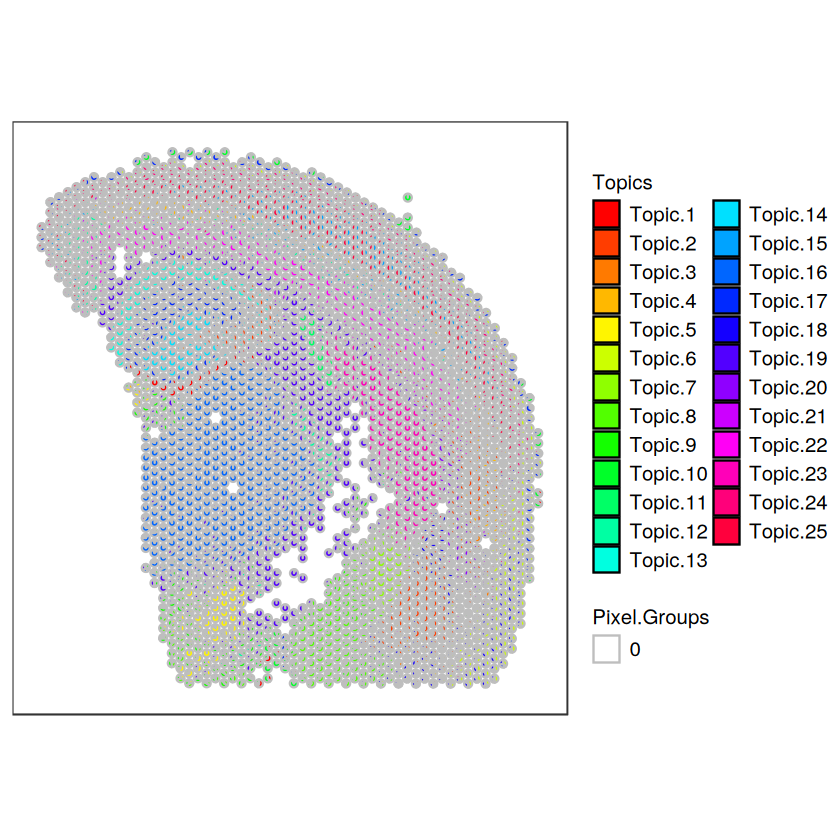

In [204]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp2,ppos, r=2.5 )

Plotting scatterpies for 2549 pixels with 25 cell-types...this could take a while if the dataset is large.




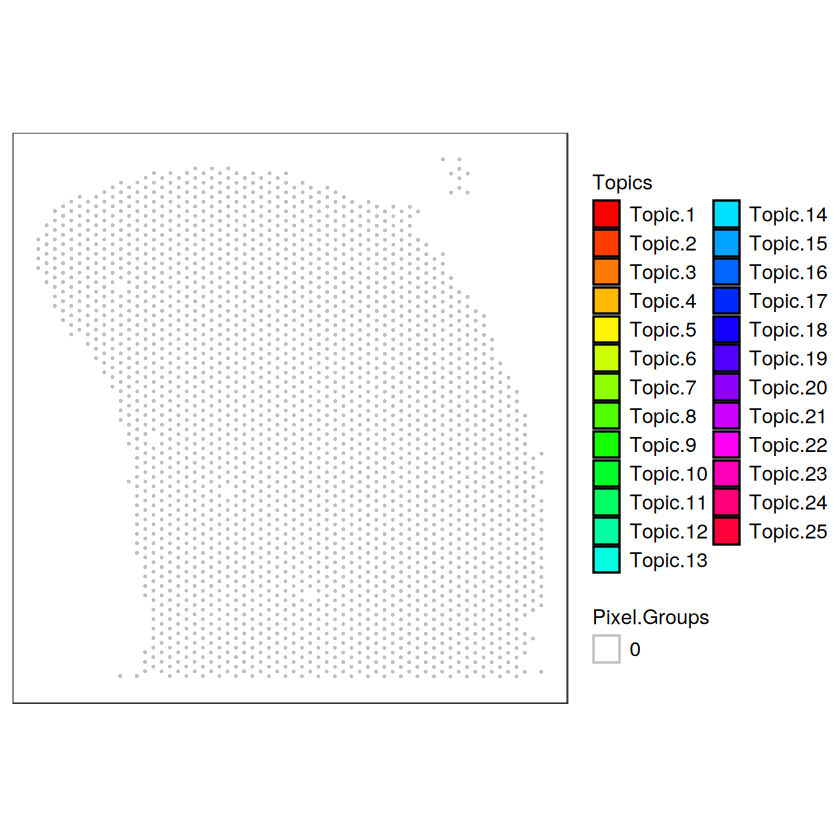

In [210]:
  ## visualize deconvolved cell-type proportions
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp,ppos, r=0.4)

Plotting scatterpies for 2176 pixels with 25 cell-types...this could take a while if the dataset is large.




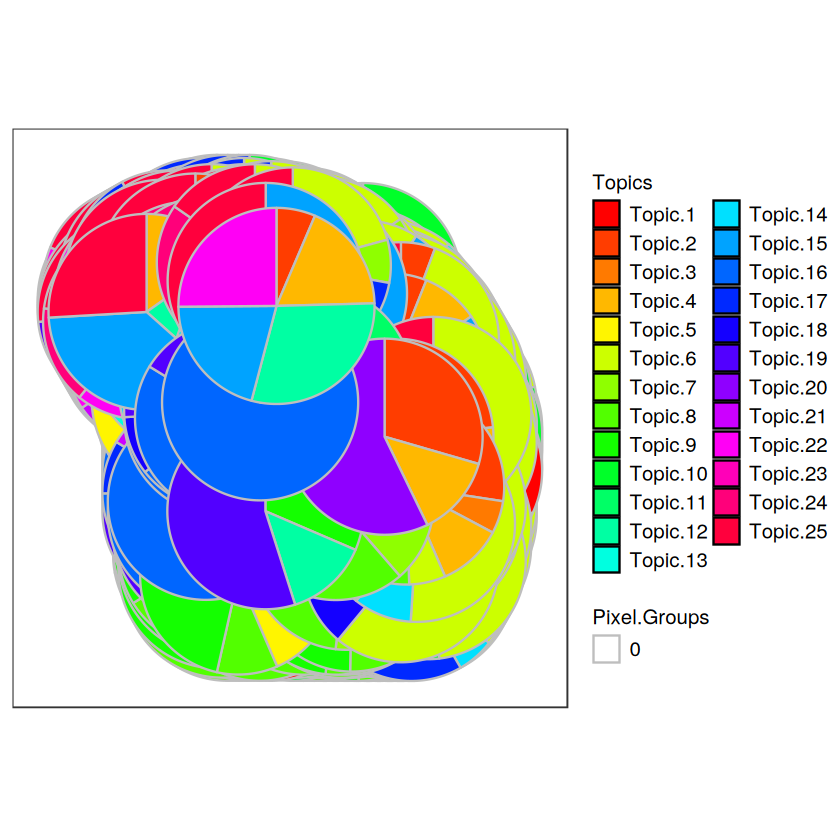

In [212]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp2,ppos, r=100 )

Plotting scatterpies for 2549 pixels with 25 cell-types...this could take a while if the dataset is large.




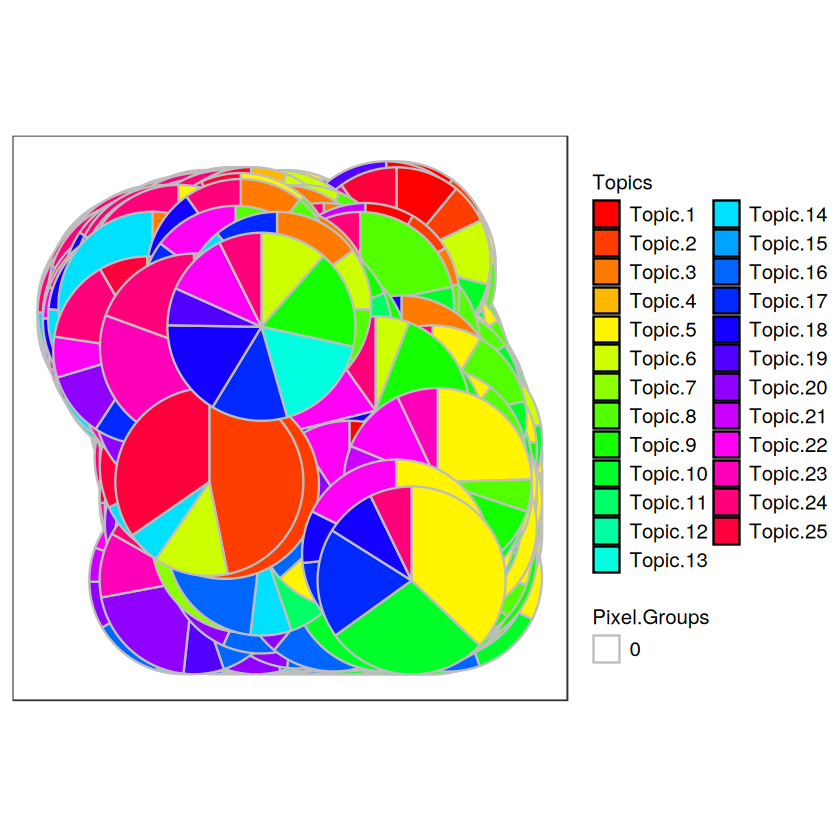

In [274]:
vizAllTopics(deconProp,ppos, r=100 )

Plotting scatterpies for 2549 pixels with 25 cell-types...this could take a while if the dataset is large.




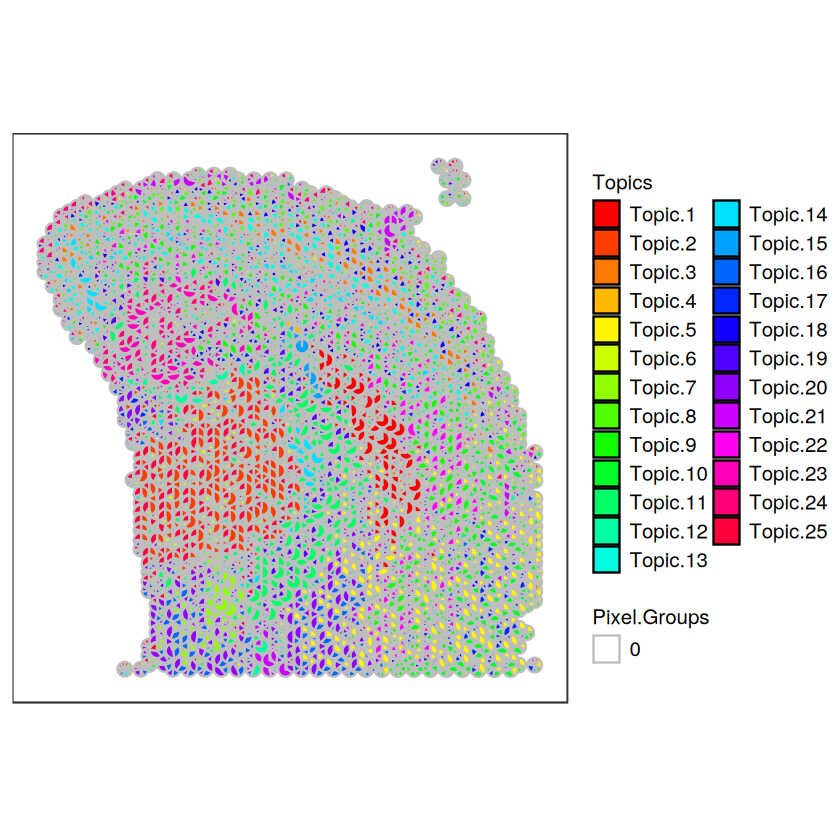

In [214]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp,ppos, r=5 )

Plotting scatterpies for 2176 pixels with 25 cell-types...this could take a while if the dataset is large.




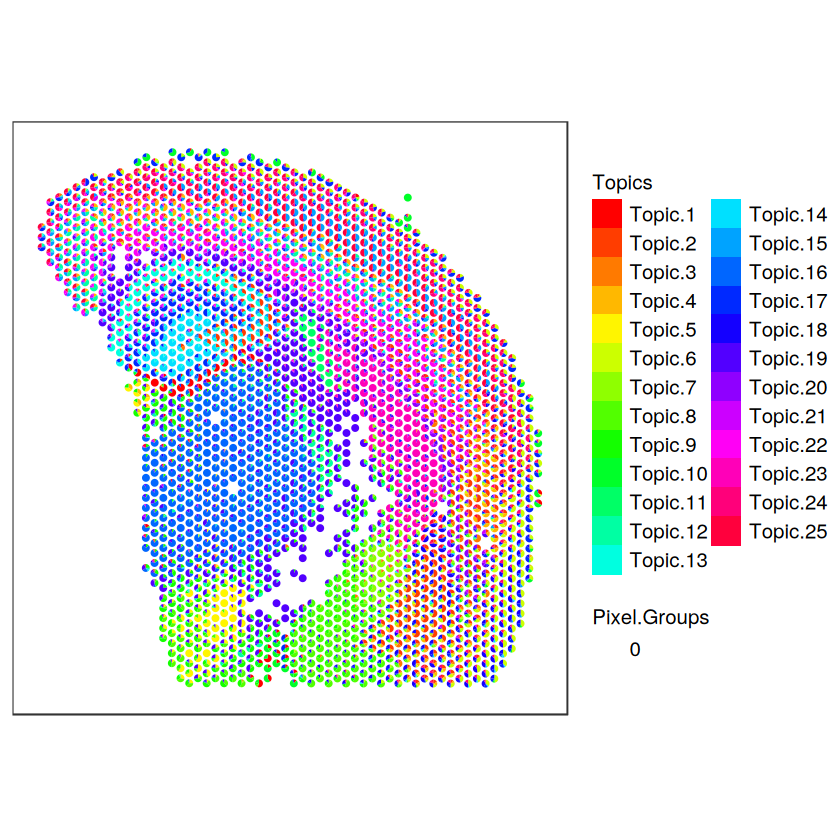

In [218]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizAllTopics(deconProp2,ppos, r=2.5, lwd=0 )

In [280]:
dim(deconGexp)

[1]  25 476

In [164]:
dim(deconGexp2)

[1]   25 1000

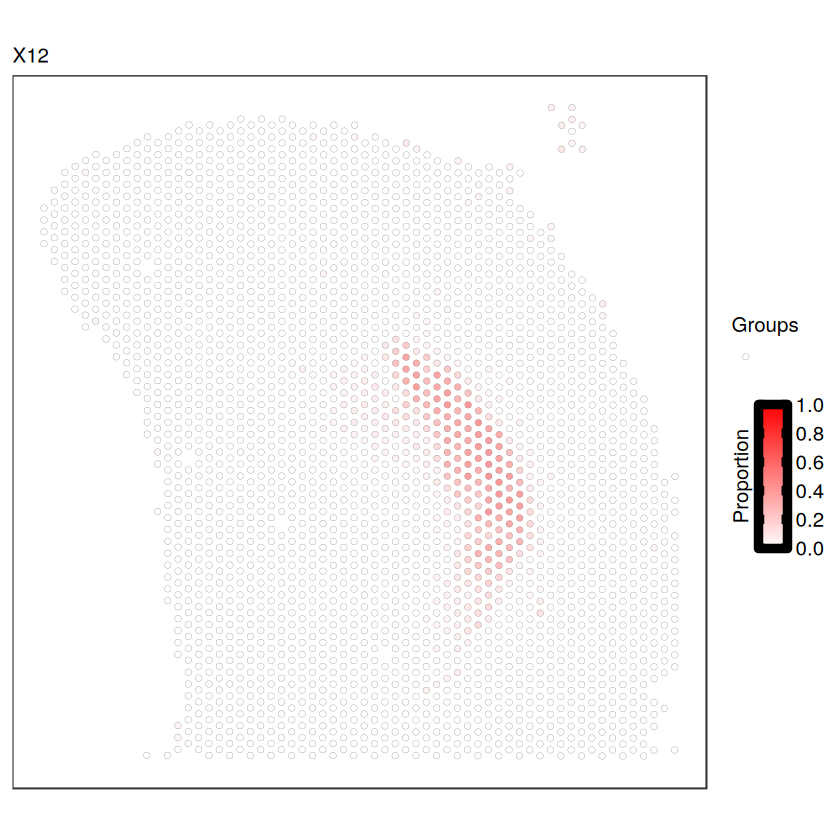

In [250]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizTopic(theta = deconProp, pos = ppos, topic = "1", plotTitle = "X12",
         size = 1.5, stroke = 0.1, alpha = 0.5,
         low = "white",
         high = "red")

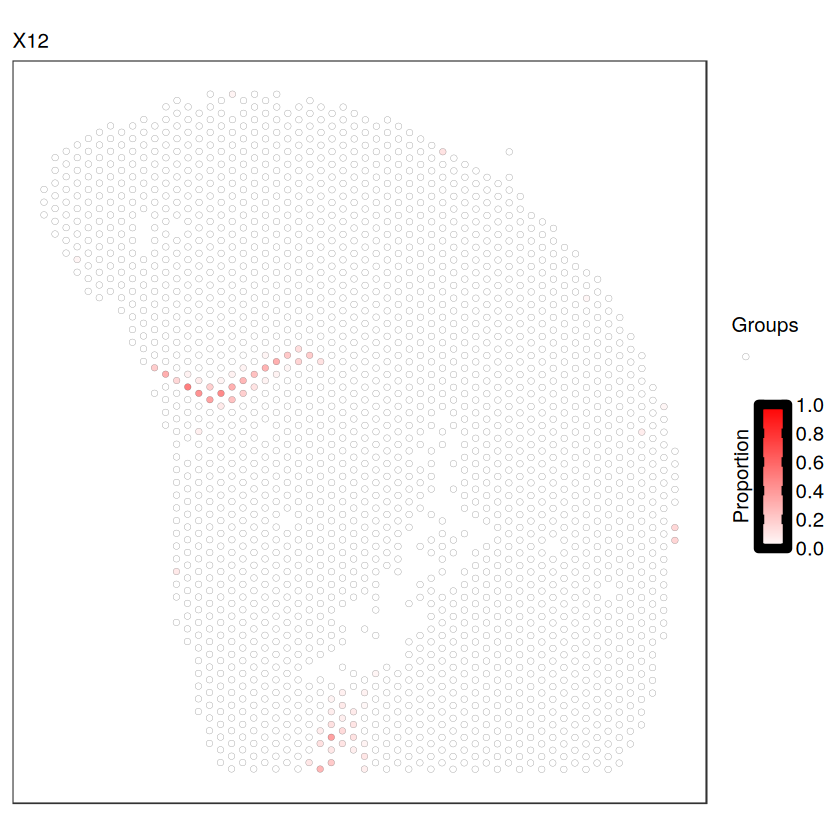

In [252]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizTopic(theta = deconProp2, pos = ppos2, topic = "1", plotTitle = "X12",
         size = 1.5, stroke = 0.1, alpha = 0.5,
         low = "white",
         high = "red")

In [304]:
optLDA2 <- optimalModel(models = ldas2, opt = "25")
results2 <- getBetaTheta(optLDA2, perc.filt = 0.05, betaScale = 1000)
deconProp2 <- results2$theta
deconGexp2 <- results2$beta

Filtering out cell-types in pixels that contribute less than 0.05 of the pixel proportion.




In [306]:
genes.shared <- intersect(rownames(deconGexp),rownames(deconGexp2))
length(genes.shared)

[1] 25

In [308]:
genes.shared <- intersect(colnames(deconGexp),colnames(deconGexp2))
length(genes.shared)

[1] 351

In [310]:
cmat <- cor(deconGexp[,genes.shared],deconGexp2[,genes.shared]   )

In [312]:
dim(cmat)

[1] 351 351

In [314]:
cmat <- cor(t(deconGexp[,genes.shared]),t(deconGexp2[,genes.shared]))

In [316]:
dim(cmat)

[1] 25 25

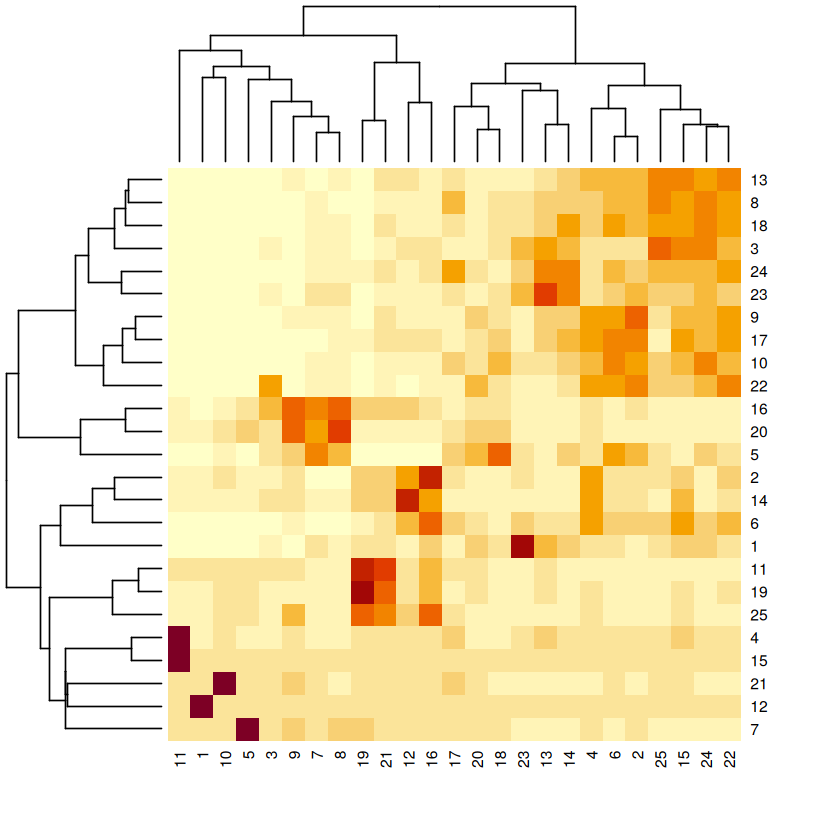

In [318]:
heatmap(cmat)

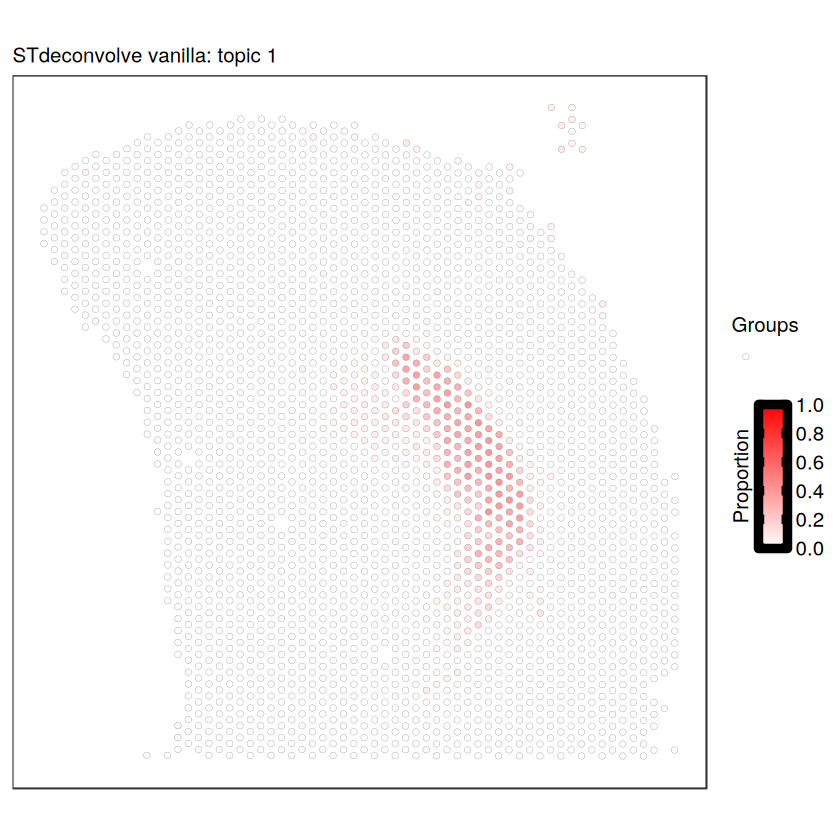

In [238]:
vizTopic(theta = deconProp, pos = ppos, topic = "1", plotTitle = "STdeconvolve vanilla: topic 1",
         size = 1.5, stroke = 0.1, alpha = 0.5,
         low = "white",
         high = "red")

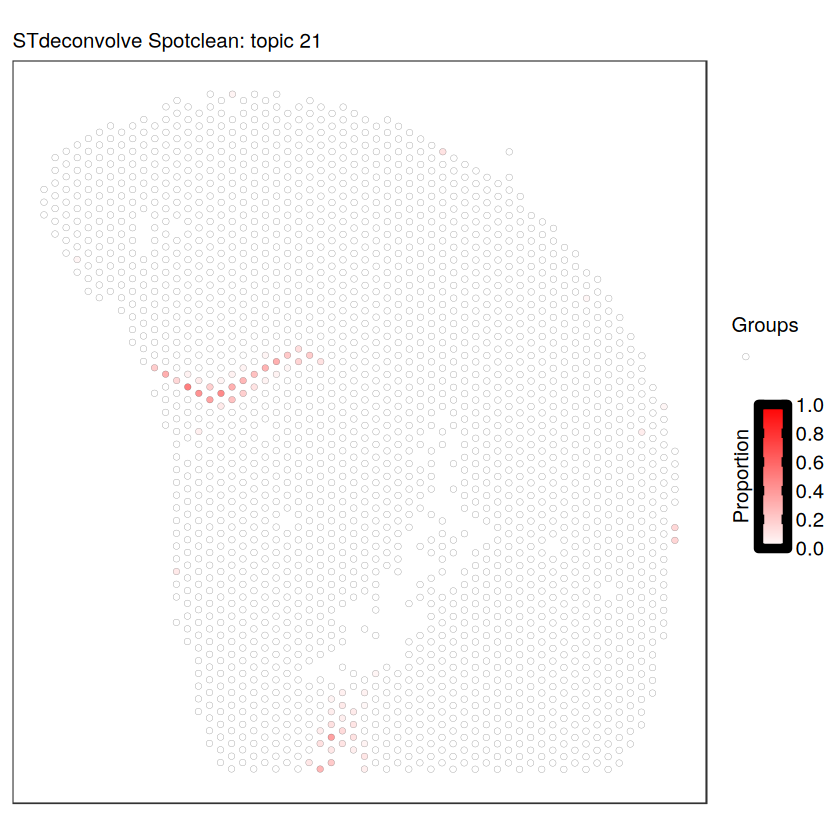

In [240]:
ppos <-  pos[rownames(deconProp),]
colnames(ppos) <- c('x','y')
vizTopic(theta = deconProp2, pos = ppos2, topic = "1", plotTitle = "STdeconvolve Spotclean: topic 21 ",
         size = 1.5, stroke = 0.1, alpha = 0.5,
         low = "white",
         high = "red")

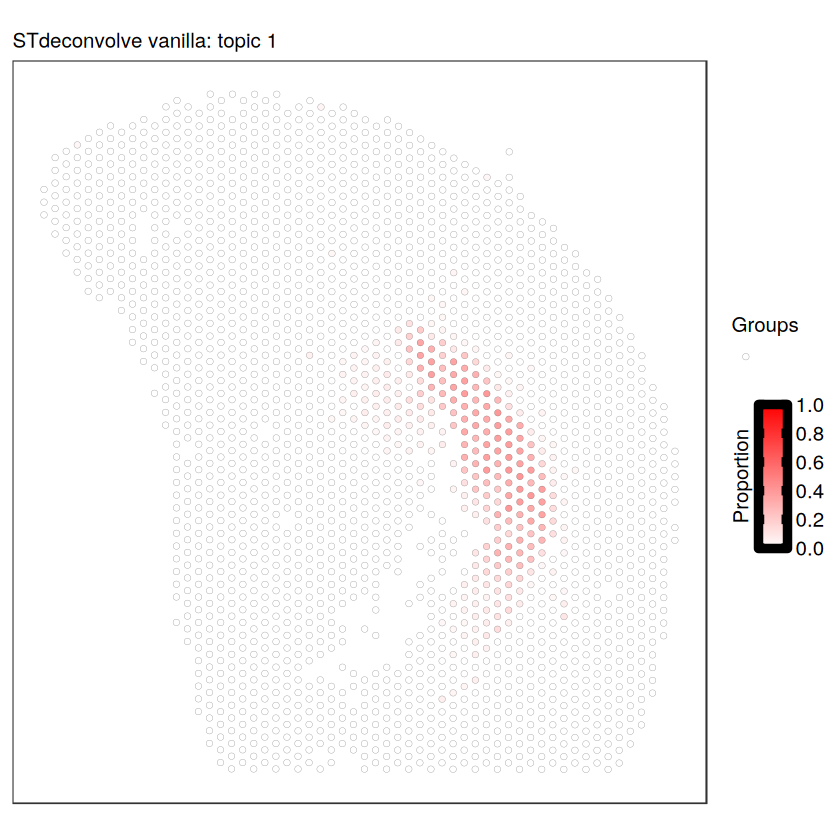

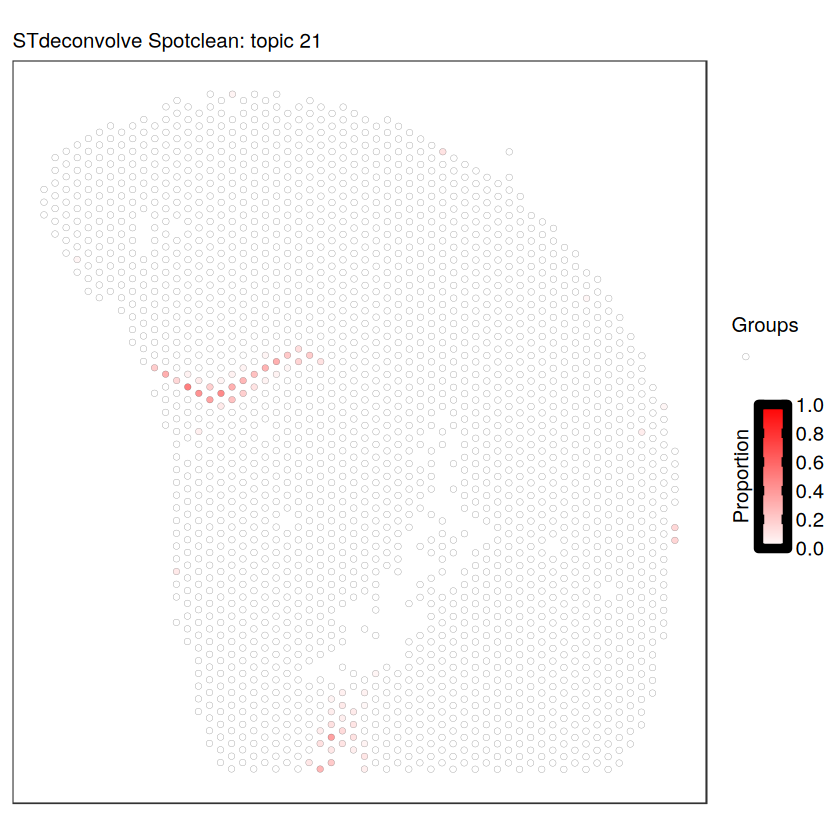

In [242]:
spot.shared <- intersect(rownames(ppos),rownames(ppos2) )
vizTopic(theta = deconProp, pos = ppos[spot.shared,], topic = "1", plotTitle = "STdeconvolve vanilla: topic 1",
         size = 1.5, stroke = 0.1, alpha = 0.5,
         low = "white",
         high = "red")
vizTopic(theta = deconProp2, pos = ppos2[spot.shared,], topic = "1", plotTitle = "STdeconvolve Spotclean: topic 21 ",
         size = 1.5, stroke = 0.1, alpha = 0.5,
         low = "white",
         high = "red")


In [244]:
x <- deconProp[spot.shared,21]
y <- deconProp[spot.shared,1]
length(x)
length(y)

[1] 2176

[1] 2176

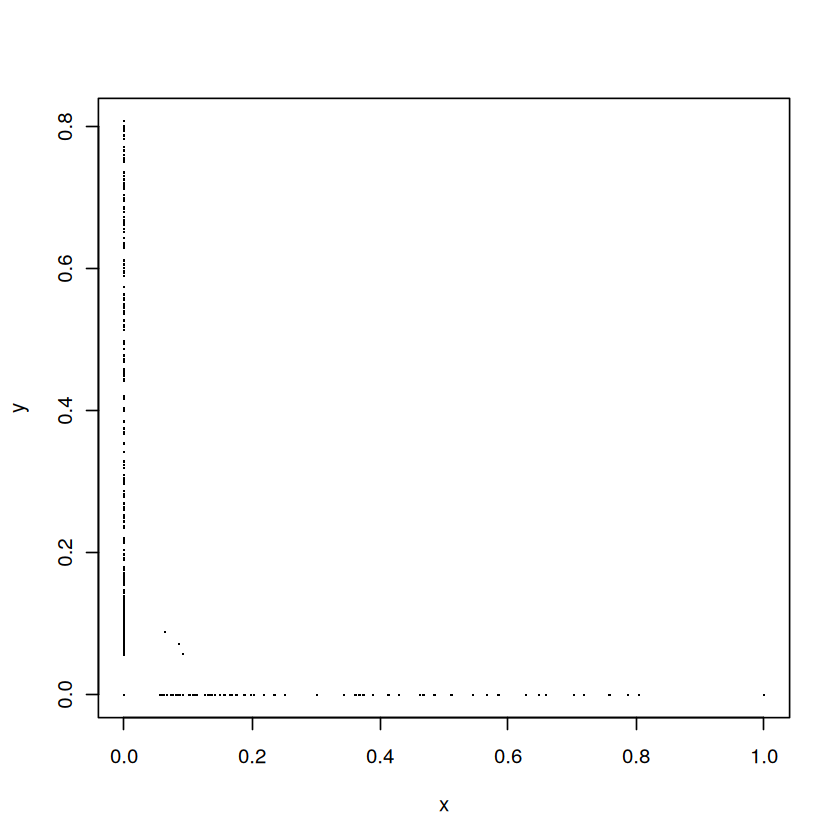

In [246]:
plot(x,y, pch=".")

In [248]:
cor.test(as.numeric(x),as.numeric(y))


	Pearson's product-moment correlation

data:  as.numeric(x) and as.numeric(y)
t = -1.8258, df = 2174, p-value = 0.06802
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 -0.08101547  0.00289732
sample estimates:
        cor 
-0.03912806 


In [382]:
	save.image(file='myEnvironment.RData')